<a href="https://colab.research.google.com/github/HideLord/ChEATER-notebook/blob/master/MessengerManip.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Abstract

In this project I will conduct an all-encompassing analysis of our groupchat, hopefully extracting interesting information and bettering my understanding of the complex social interactions and relations happening beneath the surface of not only the best highschool in bulgaria, but the best class in said school - the cream of the crop. 
<br/>
![HighIQChatting](https://drive.google.com/uc?id=1iQqqmDsFZksbgxialu7qeLaknffE56Wr)
<br/>
The perfect punctuation, spelling and overall consistency of the text provides the ideal opportunity for the extensive research, the experience only amplified by the deep and mature themes, being discussed there.
<br/>
![alt text](https://drive.google.com/uc?id=1M6Tsb7RpiND_oJYapZFHENxXWIXDOQ5d)
<br/>


# **Collecting the data**
The first step is always actually collecting the data. Fortunatelly this will be quite easy as facebook provides a convenient way for us to download all of the info it has amassed about us. Said info also contains a backup of all of our private and public chatlogs including in my case, our group chat.
<br>

###1.   First you should go to the settings tab in facebook.com<br>
![alt text](https://drive.google.com/uc?id=1Q1Qfp0XqTPA3VynV8dWdCvJenBZa4TtX)<br/>
<br/>
###2.   Navigate to the 'Your Facebook Information' tab<br>
![alt text](https://drive.google.com/uc?id=1pL9oNzfCCHsjs0XbEWyPX98l00iidsiM)<br/>
<br/>
###3.   Press 'view' on the 'Download Your Information' row<br>
![alt text](https://drive.google.com/uc?id=1P4wsAHF1RmtarVIndmEUR4WerdLvCmW5)<br/>
<br/>
###4.   On the next page select low quality HTML file<br>
![alt text](https://drive.google.com/uc?id=1EwCBnT7fc_O4Gy4MS_skh57a3MEOXqW1)<br/>
<br/>
###5.   Deselect every item except 'Messages' as the others have no intrinsic merit, unless being creeped out is your thing. <br>
![alt text](https://drive.google.com/uc?id=1c-Wz6gVEt9VEOxJfLRu3g7d_5kUvZCrD)<br/>
<br/>
###6.   Press 'Create File'. Once you've downloaded the archive, navigate to your chatlogs which are located in messages/inbox/. There you can find the specific chat you are searching for (for example mine is called 'freebobbyshmurda_rgmhjk3kma'):<br>
![alt text](https://drive.google.com/uc?id=1ABMstYpwk3U442PDQPdKykLOuI6HDUdk)
<br/>
<br/>
###7.  There you will find a bunch of folders and the file of interest called **message.html**<br>
![alt text](https://drive.google.com/uc?id=1iMuwMfAgHfMEABZTX1zHb9fPa9wP-dlS)<br/>
<br/>

From there it gets a bit more complicated to port those massages into google colab's file system, but if you are interested I will make a further tutorial, which will teach you how to analyze a custom chat and not just mine.

In [0]:
!pip install transliterate
!pip install adjustText
!pip install gender_guesser
!pip install emoji

In [0]:
from urllib.request import Request, urlopen
from bs4 import BeautifulSoup
import numpy as np
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt
import matplotlib.colors as colors
%matplotlib inline  
import math
from matplotlib.lines import Line2D
import bs4
import re
from google.colab import drive
from transliterate import translit
import gensim
from gensim.models import word2vec
import string, os
from datetime import datetime

from __future__ import print_function
from keras.callbacks import LambdaCallback
from keras.models import Sequential
from keras.layers import Dense,Dropout
from keras.layers import LSTM
from keras.optimizers import RMSprop,Adam
from keras.utils.data_utils import get_file
from keras.models import load_model

import pandas as pd
import random
import sys
import io
import collections

from emoji import UNICODE_EMOJI
from adjustText import adjust_text
from gender_guesser.detector import Detector

from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.manifold import Isomap,SpectralEmbedding,TSNE,MDS
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn import svm

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


# Dumpster diving

<font size='3'>
Now that we have the data, we must parse it. This isn't as easy as it sounds. And there is nobody to blame but me for this one. Remeber how I told you that you should download the information using the html format. It would have been much easier to do this whole thing if we had chosen the JSON format, but that would mean leaving my comfort zone and no thanks. Thankfully, this is python, so all we have to do is type the magic word 'import' and save ourselves 500k lines of code! And as you may have noticed we just passed a lot of imports above, one of which was Beautifulsoup (just the tool we need for anything html).<br>
Another big problem is the лангуидж юзед ин дъ чат. Some of it being in good ol' cyrillic and some in latin. Below you will see our first function - translating proper Bulgarian to shlockavica, intuitivly named bgToShlock(). I've also defined some common words and some which are generated from facebook automatically. ![alt text](https://drive.google.com/uc?id=1goZm-BNOxNncFmQd_VI3CEpWzcH53Aco)</font>

In [0]:
def bgToShlock(texts):
  finalStr = []
  for c in texts:
    if(c == 'я'): finalStr.append('q')
    elif(c == 'ъ'): finalStr.append('y')
    elif(c == 'ц'): finalStr.append('c')
    elif(c == 'ж' or c == 'й'): finalStr.append('j')
    else: finalStr.append(c)
  texts = ''.join(finalStr)
  texts = translit(texts, "bg", reversed=True)
  return texts

forbidden = 'mai shto nqmam taq toq koi imam imame are ama abe she ma kvo tva nali а автентичен аз ако ала бе без беше би бивш бивша бившо бил била били било благодаря близо бъдат бъде бяха в вас ваш ваша вероятно вече взема ви вие винаги внимава време все всеки всички всичко всяка във въпреки върху г ги главен главна главно глас го година години годишен д да дали два двама двамата две двете ден днес дни до добра добре добро добър докато докога дори досега доста друг друга други е евтин едва един една еднаква еднакви еднакъв едно екип ето живот за забавям зад заедно заради засега заспал затова защо защото и из или им има имат иска й каза как каква какво както какъв като кога когато което които кой който колко която къде където към лесен лесно ли лош м май малко ме между мек мен месец ми много мнозина мога могат може мокър моля момента му н на над назад най направи напред например нас не него нещо нея ни ние никой нито нищо но нов нова нови новина някои някой няколко няма обаче около освен особено от отгоре отново още пак по повече повечето под поне поради после почти прави пред преди през при пък първата първи първо пъти равен равна с са сам само се сега си син скоро след следващ сме смях според сред срещу сте съм със също т тази така такива такъв там твой те тези ти т.н. то това тогава този той толкова точно три трябва тук тъй тя тях у утре харесва хиляди ч часа че често чрез ще щом юмрук я як'
forbidden = bgToShlock(forbidden).split(' ')
generatedText = ['sent','voted','poll','admin','responded','removed','added','nickname','scored','group','EverWing','changed','премахна','добави','снимка','изпрати','plan','план','started','reminder','leaderboard']

print(forbidden)

soup = BeautifulSoup(open("gdrive/My Drive/message.html"), "html.parser")
messages = soup.findAll('div',{'class','pam _3-95 _2pi0 _2lej uiBoxWhite noborder'})
messages.reverse()
#soup = BeautifulSoup(open("gdrive/My Drive/messageShitspam.html"), "html.parser")
#messages.extend( soup.findAll('div',{'class','pam _3-95 _2pi0 _2lej uiBoxWhite noborder'}) )
print('collected messages: ', len(messages))


['mai', 'shto', 'nqmam', 'taq', 'toq', 'koi', 'imam', 'imame', 'are', 'ama', 'abe', 'she', 'ma', 'kvo', 'tva', 'nali', 'a', 'avtentichen', 'az', 'ako', 'ala', 'be', 'bez', 'beshe', 'bi', 'bivsh', 'bivsha', 'bivsho', 'bil', 'bila', 'bili', 'bilo', 'blagodarq', 'blizo', 'bydat', 'byde', 'bqha', 'v', 'vas', 'vash', 'vasha', 'veroqtno', 'veche', 'vzema', 'vi', 'vie', 'vinagi', 'vnimava', 'vreme', 'vse', 'vseki', 'vsichki', 'vsichko', 'vsqka', 'vyv', 'vypreki', 'vyrhu', 'g', 'gi', 'glaven', 'glavna', 'glavno', 'glas', 'go', 'godina', 'godini', 'godishen', 'd', 'da', 'dali', 'dva', 'dvama', 'dvamata', 'dve', 'dvete', 'den', 'dnes', 'dni', 'do', 'dobra', 'dobre', 'dobro', 'dobyr', 'dokato', 'dokoga', 'dori', 'dosega', 'dosta', 'drug', 'druga', 'drugi', 'e', 'evtin', 'edva', 'edin', 'edna', 'ednakva', 'ednakvi', 'ednakyv', 'edno', 'ekip', 'eto', 'jivot', 'za', 'zabavqm', 'zad', 'zaedno', 'zaradi', 'zasega', 'zaspal', 'zatova', 'zashto', 'zashtoto', 'i', 'iz', 'ili', 'im', 'ima', 'imat', 'iska'

###Some more functions
Now that we have collected all of the messages, we must remove the useless clutter and make them a little more presentable. I made the decision to use 'pandas', which will help us construct a tidy matrix consisting of 5 sections:


1.   User - The facebook user name of the person's message
2.   Text - The actual message
3.   Reacts - A list of the users who reacted to the message and with which emoji they reacted
4.   Time - The time at which the message was sent
5.   Date - The date on which it was sent

I've also made some modifications to the original data. For example I converted the 12 hour format to the 24 hour one and made the string based date format into a more conventional M/D/Y one.


In [0]:
def parseData(): 
  userList = [i for i in range(len(messages))]
  textList = [i for i in range(len(messages))]
  reactsList = [i for i in range(len(messages))]
  timeList = [i for i in range(len(messages))]
  dateList = [i for i in range(len(messages))]

  monthDict = {'jan':'1','feb':'2', 'mar':'3', 'apr':'4', 'may':'5', 'jun':'6', 'jul':'7', 'aug':'8', 'sep':'9', 'oct':'10', 'nov':'11', 'dec':'12'}
  
  for i,m in enumerate(messages):
    #if(i==100):break
    if(i%100 == 0):
      print('\r{}/{}'.format(i,len(messages)),end='')
    user,text,reacts,time,date = None,None,None,None,None
    # user
    u = m.find('div',{'class','_3-96 _2pio _2lek _2lel'})
    if u is not None:
      user = u.text
    # message
    t = m.find('div',{'class','_3-96 _2let'})
    if t is not None:
      t = t.findNext().findNext().findNext()
      text = t.text
    # reacts
    r = m.find('ul',{'class','_tqp'})
    if r is not None:
      r = r.findChildren('li')
      reacts = [n.text for n in r]
    # time and date
    t = m.find('div',{'class','_3-94 _2lem'})
    if t is not None:
      time = t.text
      time = time.split(', ')
      if len(time) == 3:
        date = monthDict[time[0][0:3].lower()] + '-' + time[0][4:] + '-' + time[1]
        time = time[2]
        '''if time[-2:] == "AM" and time[:2] == "12": 
          time = "00" + time[2:-2] 
        elif time[-2:] == "AM": 
          time = time[:-2] 
        elif time[-2:] == "PM" and time[:2] == "12": 
          time = time[:-2] 
        else: 
          time = str(int(time[:2].replace(':','')) + 12) + time[2:-3]'''
        time = datetime.strptime(time, '%I:%M %p')
        time = datetime.strftime(time, "%H:%M")
      
    userList[i] = user
    textList[i] = text
    reactsList[i] = reacts
    timeList[i] = time
    dateList[i] = date
    
  data = pd.DataFrame({'user':userList,'text':textList,'reacts':reactsList,'time':timeList, 'date':dateList}, columns=['user','text','reacts','time','date'])
  return data

In [0]:
data = parseData()
print("\n")
data.head(10000)

64200/64232



,user,text,reacts,time,date
0,Alex Savova,дневника named the group Втора група 💎👗👗💎зарад...,None,09:45,6-20-2016
1,Ivan Kirev,Не и флейм named the group 💎👗👗💎.,None,09:45,6-20-2016
2,Alex Savova,дневника added you and 3 others.,None,09:45,6-20-2016
3,Alex Savova,дневника added Boyan Ivandjikov and 4 others.,None,09:46,6-20-2016
4,Alex Savova,дневника added a participant.,None,09:46,6-20-2016
5,Georgi Rulev,?????,None,09:47,6-20-2016
6,Yoana Pavlova,a spomenite ot starata grupa??,None,09:48,6-20-2016
7,Alex Savova,дневника added Любен Тодоров and 3 others.,None,09:48,6-20-2016
8,Alex Savova,Жертваме ги в полза на колектива.... *Кирев е ...,None,09:49,6-20-2016
9,Жаклин Ковачева,Някой от школата,None,09:49,6-20-2016


###Even more functions

Below is a massive piece of garbag- I mean code that I made to help me collect some general data about the chat.
From top to bottom:


1.   getMostUsedWords() - goes through the messages, translates them to shlockavica, tokenizes the sentences, removing the punctuation, emojis and hieroglyphs(yes there were some) and leaves the pure words. Those words are then counted and it returns a dictionary where each word has its own counter. 
2.   getMessagesPerUser() - this one is pretty self-explanatory.
3.   getAveWordsPerUser() - it returns the average words per message for every username in the database. It repeats the process of cleaning and tokenizing from       the first function so that it leaves the pure words and then counts them, summing them up for every user and returning the average.
4.   getRangeDays() - it looks for the first and last message of every user and returns the time range in days.
5.   getTextFromUser() - it can either return all of the texts from a single user or a group. It does some basic cleaning as well as the usual translation to shlockavica.



In [0]:
def getMostUsedWords(topN, userNames = None):
  texts = []
  if userNames is None:
    texts = data['text'].tolist()
  else:
    texts = data.loc[data['user'].isin(userNames)]['text'].tolist()
  texts = [t for t in texts if t is not None]
  texts = ('\n'.join([t for t in texts if not any(g in t for g in generatedText)])).lower()
  texts = bgToShlock(texts)
  
  tokens = texts.split()
  table = str.maketrans('', '', string.punctuation)
  tokens = [w.translate(table) for w in tokens]
  tokens = [word for word in tokens if word.isalpha()]
  tokens = [word.lower() for word in tokens]
  tokens = [word for word in tokens if word not in forbidden]
  
  wordcount = {}
  for word in tokens:
    if word not in wordcount:
      wordcount[word] = 1
    else:
      wordcount[word] += 1
  
  word_counter = collections.Counter(wordcount)
  return word_counter.most_common(topN)

def getMessagesPerUser():
  names = data.loc[data['user'].notnull()]['user'].tolist()  
  namecount = {}
  for name in names:
    
    if name not in namecount:
      namecount[name] = 1
    else:
      namecount[name] += 1
  
  name_counter = collections.Counter(namecount)
  return name_counter.most_common()

def getAveWordsPerUser():
  users = data.loc[data['user'].notnull()]['user'].tolist()  
  texts = data.loc[data['user'].notnull()]['text'].tolist()  
  users = [users[i] for i,t in enumerate(texts) if not any(g in t for g in generatedText)]
  texts = [t for t in texts if not any(g in t for g in generatedText)]
  
  table = str.maketrans('', '', string.punctuation)
  namecount = {}
  messageCounter = {}
  for i,name in enumerate(users):
    text = texts[i]
    text = bgToShlock(text)
    tokens = text.split()
    tokens = [w.translate(table) for w in tokens]
    tokens = [word for word in tokens if word.isalpha()]
    if name not in namecount:
      messageCounter[name] = 1
      namecount[name] = len(tokens)
    else:
      messageCounter[name] += 1
      namecount[name] += len(tokens)
      
  for n,v in messageCounter.items():
    namecount[n]/=v
  return collections.Counter(namecount).most_common()

def getRangeDays():
  users = {}
  texts = data.loc[data['user'].notnull() & data['date'].notnull()][['user','date']]
  
  date_format = "%m-%d-%Y"
  
  for index, row in texts.iterrows():
    name = row['user']
    date = row['date']
    date = datetime.strptime(date, date_format)
    if name in users:
      if(date > users[name][1]):users[name][1] = date
      if(date < users[name][0]):users[name][0] = date
    else:
      users[name] = [date,date]
  return users
    
def getTextFromUser(name):
  texts = []
  if len(name)==0:
    texts = data.loc[data['user'].notnull() & data['text'].notnull()][['user','text']]
  else:
    texts = data.loc[data['user'].notnull() & data['text'].notnull() & data['user'].isin(name)][['user','text']]
  allTexts = str()
  prev = "."
  for index, row in texts.iterrows():
    sender = str(row['user'])
    text =   str(row['text']).lower()

    if any(g in text for g in generatedText):
      continue

    if sender != prev:
      allTexts += '\n'
    else:
      allTexts += ' '
    allTexts += text

    prev = str(sender)

  finalStr = []

  allTexts = allTexts.lower()

  for c in allTexts:
    if(c == 'я'): finalStr.append('q')
    elif(c == 'ъ'): finalStr.append('y')
    elif(c == 'ц'): finalStr.append('c')
    elif(c == 'ж'): finalStr.append('j')
    elif(c == ','): finalStr.append(' , ')
    elif(c == '\"'): finalStr.append(' \" ')
    elif(c == '\''): finalStr.append(' \' ')
    elif(c == '('): finalStr.append(' ( ')
    elif(c == ')'): finalStr.append(' ) ')
    elif(c == '?'): finalStr.append(' ? ')
    elif(c == '!'): finalStr.append(' ! ')
    elif(c == '.'): finalStr.append(' . ')
    elif(c == ';'): finalStr.append(' ; ')
    elif(c == ':'): finalStr.append(' : ')
    elif(c == '*'): finalStr.append(' * ')
    elif(c == '/'): finalStr.append(' / ')
    elif(c == '@'): finalStr.append(' @ ')
    elif(c == '\\'): finalStr.append(' \\ ')
    else: finalStr.append(c)

  allTexts = ''.join(finalStr)
  allTexts = translit(allTexts, "bg", reversed=True)
  allTexts = re.sub(' +', ' ', allTexts)
  return allTexts

#Visualization

##Trigger Warning

<font size='3'>
There is a lot to unpack here so lets start from the top. There we have the object guesser. Its work is to objectively guess the gender of the person it's judging entirely by his first name, based purely on statistics. Of course this tool is not perfect so I have manually added a few names and specified their gender. And as for the people for whom I am also not sure, they will be inserted into a third group aptly named 'Apache'. <br/>
<br/>
In this section we also utilize the functions from above. Now, remember the list of common and stopwords we had in the beggining. Those will finally come in handy when we are counting the most frequent words because we don't care about them.
</font>

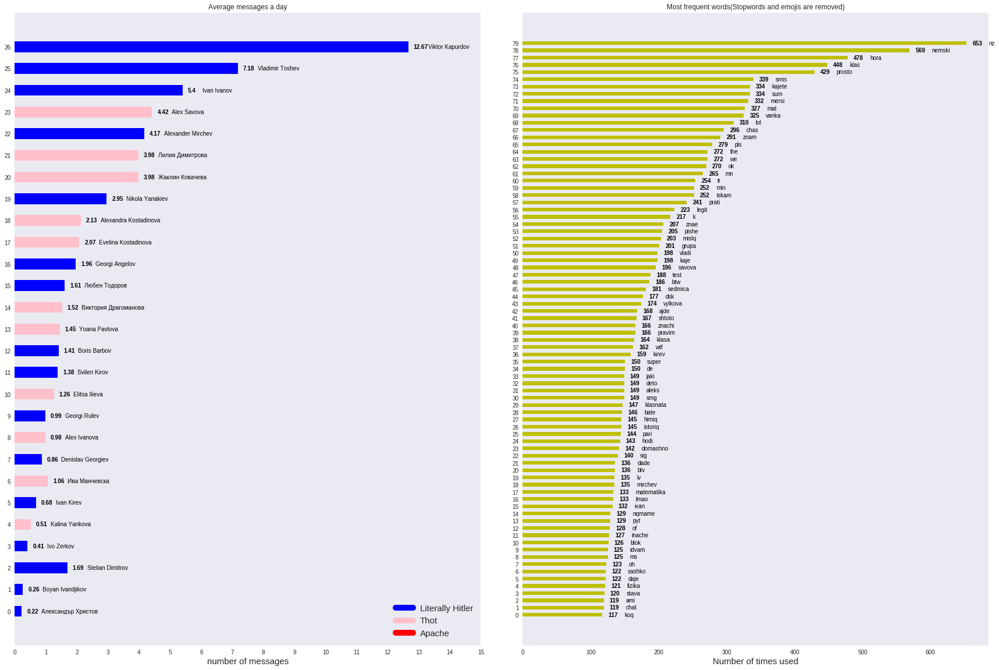

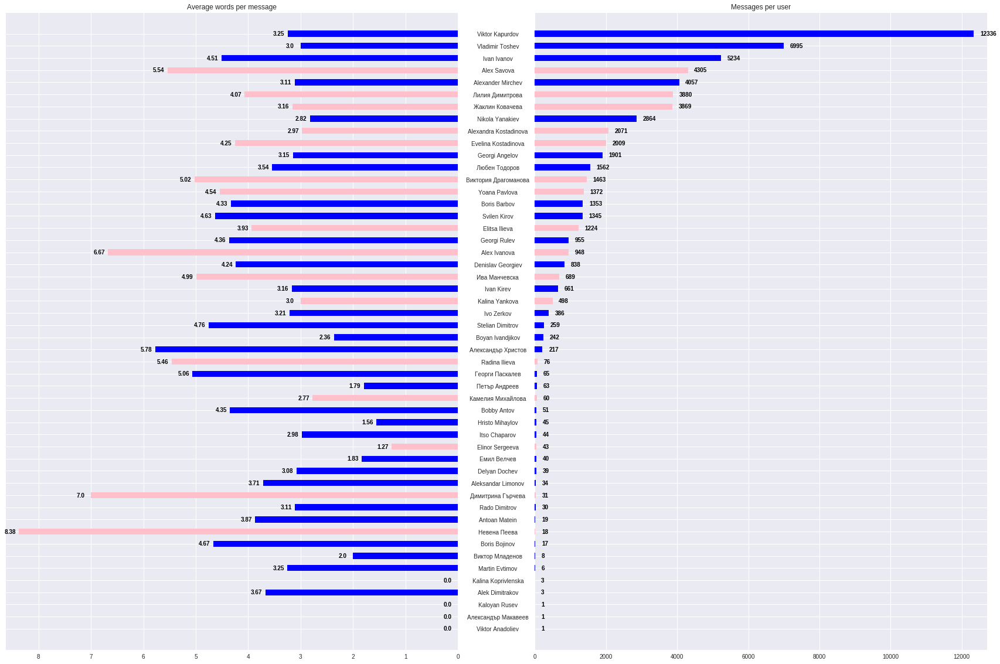

In [0]:
guesser = Detector()

fig = plt.figure(1)
fig.set_size_inches(30, 20, forward=True)
fig.subplots_adjust(wspace=0.09,hspace = 0.09)

custom_lines = [Line2D([0], [0], color='b', lw=10),
                Line2D([0], [0], color='pink', lw=10),
                Line2D([0], [0], color='red', lw=10)]

#-------------------------------------------------------------------------------
# Average messages a day
#-------------------------------------------------------------------------------
ax = fig.add_subplot(121)

AveWordsPerUser = getAveWordsPerUser()
MessagesPerUser = getMessagesPerUser()
mostUsedWords = getMostUsedWords(80)
RangeDay = getRangeDays()

threshold = 200

x = [a for key,a in MessagesPerUser]
names = [a for a,val in MessagesPerUser]

while (x[-1] < threshold):
  x.pop()
  names.pop()

x.reverse()
names.reverse()

x = [x[i]/((RangeDay[n][1]-RangeDay[n][0]).days+1) for i,n in enumerate(names)]

namesShlock = [translit(n.split()[0], "bg", reversed=True).lower().capitalize() for n in names]
namesShlock = [n.replace('Zh','J').replace('zh','j').replace('ks','x').replace('ts','c').replace('Ts','C') for n in namesShlock]
gender = [guesser.get_gender(n) for n in namesShlock]
genderDict = {'Godsgift':'male','Keni':'male','Venci':'male','Jaklin':'female','Momchi':'male','Alek':'male','Alex':'female','Denislav':'male','Yoana':'female','Taniel':'male','Tuan':'male','Kristiyan':'male'}
for i,g in enumerate(gender):
  if namesShlock[i] in genderDict:
    g = genderDict[namesShlock[i]]
  if g == 'male':
    gender[i] = 'b'
  elif g == 'female':
    gender[i] = 'pink'
  else:
    gender[i] = 'red'

index = np.arange(len(x))
bar_width = 0.5

rect = ax.barh(index, x, bar_width, color=gender)

ax.grid(False)

for i, v in enumerate(x):
    ax.text(v+(max(x)/75), i, str(round(v,2)), color='Black', fontweight='bold', verticalalignment='center')
    ax.text(v+(max(x)/20), i, str(names[i]), color='Black', verticalalignment='center')
ax.set_xticks(np.arange(min(x), max(x)*1.3, max(x)/12, np.int32))
ax.set_xlabel('number of messages',fontsize=15)
ax.set_yticks(index)
ax.set_title('Average messages a day')
ax.legend(custom_lines, ['Literally Hitler', 'Thot', 'Apache'], loc='lower right',fontsize=15)

#-------------------------------------------------------------------------------
# Most frequent words
#-------------------------------------------------------------------------------
ax = fig.add_subplot(122)

x = [a for key,a in mostUsedWords]
names = [a for a,val in mostUsedWords]

x.reverse()
names.reverse()

index = np.arange(len(x))
bar_width = 0.5

rect = ax.barh(index, x, bar_width, color='y')

ax.grid(False)

for i, v in enumerate(x):
    ax.text(v+(max(x)/75), i, str(round(v,2)), color='Black', fontweight='bold', verticalalignment='center')
    ax.text(v+(max(x)/20), i, str(names[i]), color='Black', verticalalignment='center')
ax.set_xlabel('Number of times used',fontsize=15)
ax.set_yticks(index)
ax.set_title('Most frequent words(Stopwords and emojis are removed)')

plt.savefig('fig1.png')

#-------------------------------------------------------------------------------
# Number of messages per user
#-------------------------------------------------------------------------------

fig = plt.figure(2)
fig.set_size_inches(30, 20, forward=True)
fig.tight_layout()
fig.subplots_adjust(wspace=0.17)
ax = fig.subplots(ncols=2, sharey=True)

x = [a for key,a in MessagesPerUser]
names = [a for a,val in MessagesPerUser]

x.reverse()
names.reverse()

xAve = [a for key,a in AveWordsPerUser]
namesAve = [a for a,val in AveWordsPerUser]
xAve = dict(zip(namesAve, xAve))

xAve = [xAve[n] for n in names]

namesShlock = [translit(n.split()[0], "bg", reversed=True).lower().capitalize() for n in names]
namesShlock = [n.replace('Zh','J').replace('zh','j').replace('ks','x').replace('ts','c').replace('Ts','C') for n in namesShlock]
gender = [guesser.get_gender(n) for n in namesShlock]

for i,g in enumerate(gender):
  if namesShlock[i] in genderDict:
    g = genderDict[namesShlock[i]]
  if g == 'male':
    gender[i] = 'b'
  elif g == 'female':
    gender[i] = 'pink'
  else:
    gender[i] = 'red'

index = np.arange(len(x))
bar_width = 0.5

ax[0].barh(index, xAve, bar_width, color=gender)
ax[0].set(title='Average words per message')
ax[1].barh(index, x, bar_width, color=gender)
ax[1].set(title='Messages per user')

for i, v in enumerate(x):
  ax[1].text(v+(max(x)/70), i, str(round(v,2)), color='Black', fontweight='bold', verticalalignment='center')
for i, v in enumerate(xAve):
  ax[0].text(v+(max(xAve)/30), i, str(round(v,2)), color='Black', fontweight='bold', verticalalignment='center')

ax[0].invert_xaxis()
ax[0].set(yticks=index)
ax[0].set_yticklabels(names)

import matplotlib.transforms

pos2 = ax[1].get_position()
right = pos2.bounds[0]    

pos1 = ax[0].get_position()
left = pos1.bounds[0] + pos1.bounds[2]

dx = ((right - left) / pos2.bounds[2]) * 5
offset = matplotlib.transforms.ScaledTranslation(dx, 0, fig.dpi_scale_trans)

ax[0].yaxis.tick_right()

for label in ax[0].yaxis.get_majorticklabels():
  label.set_transform(label.get_transform() + offset)
  label.set_horizontalalignment('center')



for ax in ax.flat:
    ax.margins(0.03)
    ax.grid(True)

plt.savefig('fig2.png')
    
plt.show()


##Ahh that's hot, that's hot!
First a concise description of the functions:


*   getActivityDays(): counts the number of messages for any given day
*   date_heatmap(): creates an activity heatmap, the design for which I unabashedly stole from github 

So you know how you cannot see the stars during the day because the sun is just too damn bright? Well we could draw a parallel here with the heatmap of the chat. That's the reason why I've normalized every map except the first.

1.   2017-12-13 with 1430 (The day of the reckoning)
2.   2017-06-25  with  743 (The planning for the end of the year party)
3.   2018-01-03 with 454 (When Stelian Dimitrov(the deutsch teacher) was in our chat for some reason and wrote more than 200 of the messages)

and a couple others are the metaphorical suns in this solar system. We can also see some patterns. For example during vacations it becomes pretty silent and saturday is usually a lot 'colder' than the other days.

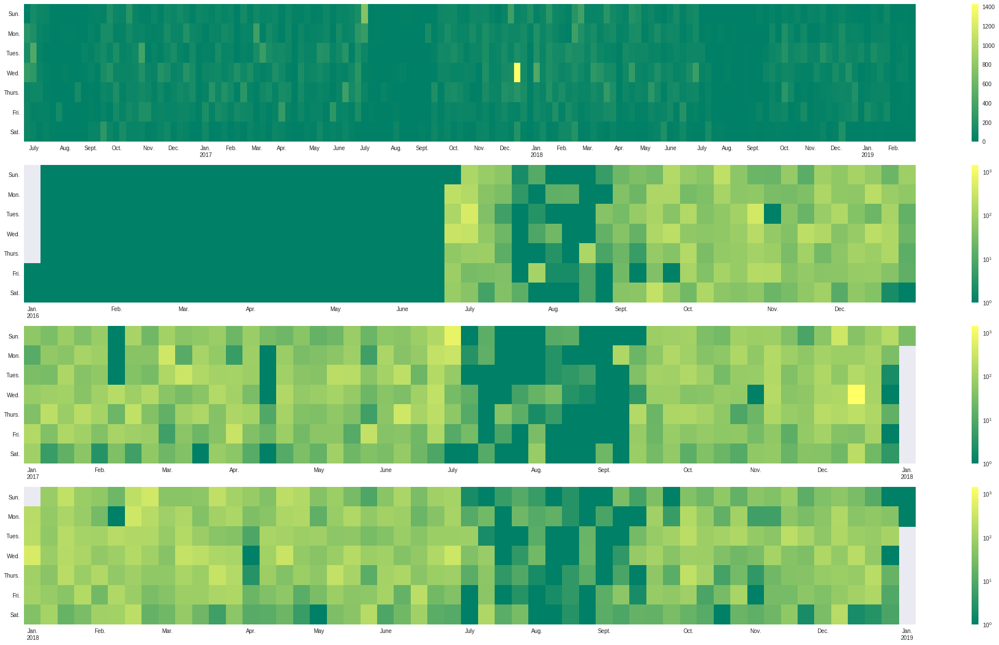

In [0]:
def getActivityDays(scale = 1.15):
  dates = data.loc[data['date'].notnull()]['date'].tolist()
  activity = {}
  for d in dates:
    pdDate = pd.to_datetime(d, format="%m-%d-%Y")
    if pdDate in activity: activity[pdDate]+=1
    else: activity[pdDate] = 1
      
  activity = activity.items()
  res = pd.Series([math.log(v,scale) if scale > 1.0 else v for t,v in activity])
  res.index = [t for t,v in activity]
  
  return res

DAYS = ['Sun.', 'Mon.', 'Tues.', 'Wed.', 'Thurs.', 'Fri.', 'Sat.']
MONTHS = ['Jan.', 'Feb.', 'Mar.', 'Apr.', 'May', 'June', 'July', 'Aug.', 'Sept.', 'Oct.', 'Nov.', 'Dec.']


def date_heatmap(series, start=None, end=None, mean=False, ax=None, **kwargs):
  # Combine values occurring on the same day.
  dates = series.index.floor('D')
  group = series.groupby(dates)
  series = group.mean() if mean else group.sum()

  # Parse start/end, defaulting to the min/max of the index.
  start = pd.to_datetime(start or series.index.min())
  end = pd.to_datetime(end or series.index.max())

  # We use [start, end) as a half-open interval below.
  end += np.timedelta64(1, 'D')

  # Get the previous/following Sunday to start/end.
  # Pandas and numpy day-of-week conventions are Monday=0 and Sunday=6.
  start_sun = start - np.timedelta64((start.dayofweek + 1) % 7, 'D')
  end_sun = end + np.timedelta64(7 - end.dayofweek - 1, 'D')

  # Create the heatmap and track ticks.
  num_weeks = (end_sun - start_sun).days // 7
  heatmap = np.zeros((7, num_weeks))
  ticks = {}  # week number -> month name
  for week in range(num_weeks):
      for day in range(7):
          date = start_sun + np.timedelta64(7 * week + day, 'D')
          if date.day == 1:
              ticks[week] = MONTHS[date.month - 1]
          if date.dayofyear == 1:
              ticks[week] += f'\n{date.year}'
          if start <= date < end:
            if(date in series.index):
              heatmap[day, week] = series.get(date) 
            else: heatmap[day, week] = 1
              

  # Get the coordinates, offset by 0.5 to align the ticks.
  y = np.arange(8) - 0.5
  x = np.arange(num_weeks + 1) - 0.5

  # Plot the heatmap. Prefer pcolormesh over imshow so that the figure can be
  # vectorized when saved to a compatible format. We must invert the axis for
  # pcolormesh, but not for imshow, so that it reads top-bottom, left-right.
  ax = ax or plt.gca()
  mesh = ax.pcolormesh(x, y, heatmap, cmap='summer', **kwargs)
  ax.invert_yaxis()
  fig.colorbar(mesh,ax=ax)

  # Set the ticks.
  ax.set_xticks(list(ticks.keys()))
  ax.set_xticklabels(list(ticks.values()))
  ax.set_yticks(np.arange(7))
  ax.set_yticklabels(DAYS)

  # Set the current image and axes in the pyplot API.
  plt.sca(ax)
  plt.sci(mesh)

  return ax

hm = getActivityDays(1.0)

fig = plt.figure(3)
fig.set_size_inches(35, 20, forward=True)
fig.tight_layout()
fig.subplots_adjust(hspace=0.17)
ax = fig.subplots(nrows=4)

date_heatmap(hm, ax=ax[0])

date_heatmap(hm, start='2016/1/1',end='2016/12/31', ax=ax[1], norm=colors.LogNorm(vmin=hm.min(), vmax=hm.max()))
date_heatmap(hm, start='2017/1/1',end='2017/12/31', ax=ax[2], norm=colors.LogNorm(vmin=hm.min(), vmax=hm.max()))
date_heatmap(hm, start='2018/1/1',end='2018/12/31', ax=ax[3], norm=colors.LogNorm(vmin=hm.min(), vmax=hm.max()))

In [0]:
print(hm.nlargest())

2017-12-13    1430
2017-06-25     743
2016-06-28     454
2018-01-03     448
2016-10-25     388
dtype: int64


##Einstain would be proud
The hourly activity of the group chat. The first graph represents the activity throughout the whole existance of the chat while the second is devided between first and second shift and the two plots are overlapped.<br>
*'Fun'* fact: ~30% of the messages sent between 4am and 6am are about the final chemistry test, when a bunch of us pulled an all-nighter.<br>
![alt text](https://drive.google.com/uc?id=1dJIoJpIv3_4eeZ59331QQWYd-j21-TEw)

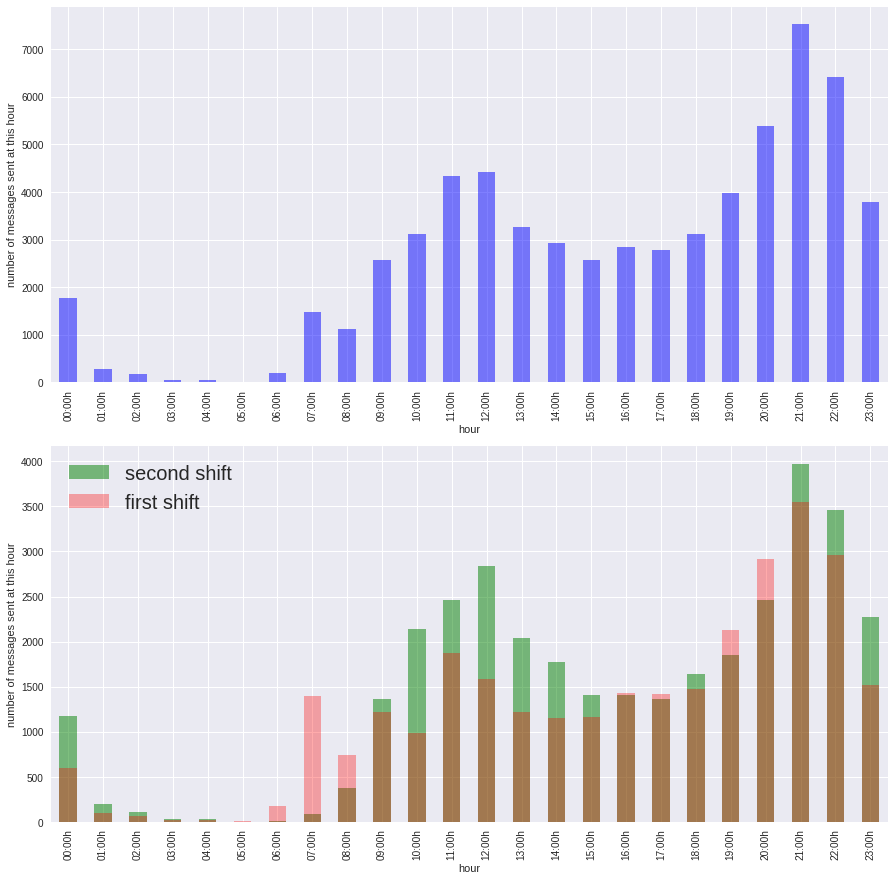

In [0]:
def isTime(t):
  if(len(str(t))==5):return True
  return False
timesAll = data.loc[data['time'].str.len()==5][['time']]

timesAll['hour']=pd.to_datetime(timesAll['time'],format='%H:%M')
timesAll.set_index('hour', drop=False, inplace=True)
timesAll = timesAll['hour'].groupby(pd.Grouper(freq='60Min')).count()

fig = plt.figure(4)
fig.set_size_inches(15, 15, forward=True)
fig.tight_layout()
fig.subplots_adjust(hspace=0.17)
ax = fig.subplots(nrows=2)

ax[0] = timesAll.plot(kind='bar', color='b', alpha=0.5, ax = ax[0])
ticklabels = timesAll.index.strftime('%H:%Mh')
ax[0].xaxis.set_major_formatter(matplotlib.ticker.FixedFormatter(ticklabels))
ax[0].set_ylabel('number of messages sent at this hour')

timesSecond = data.loc[(data['time'].str.len()==5) & ((data['date']>'8-') | (data['date']<'2-'))][['time']]

timesSecond['hour']=pd.to_datetime(timesSecond['time'],format='%H:%M')
timesSecond.set_index('hour', drop=False, inplace=True)
timesSecond = timesSecond['hour'].groupby(pd.Grouper(freq='60Min')).count()

ax[1] = timesSecond.plot(kind='bar', color='g', alpha=0.5, ax=ax[1], label='second shift')
ticklabels = timesSecond.index.strftime('%H:%Mh')
ax[1].xaxis.set_major_formatter(matplotlib.ticker.FixedFormatter(ticklabels))

timesThird = data.loc[(data['time'].str.len()==5) & ~((data['date']>'8-') | (data['date']<'2-'))][['time']]

timesThird['hour']=pd.to_datetime(timesThird['time'],format='%H:%M')
timesThird.set_index('hour', drop=False, inplace=True)
timesThird = timesThird['hour'].groupby(pd.Grouper(freq='60Min')).count()

ax[1] = timesThird.plot(kind='bar', color='r', alpha=0.33, ax=ax[1], label='first shift')
ticklabels = timesThird.index.strftime('%H:%Mh')
ax[1].xaxis.set_major_formatter(matplotlib.ticker.FixedFormatter(ticklabels))
ax[1].set_ylabel('number of messages sent at this hour')
ax[1].legend(loc='upper left',prop={'size': 20})

plt.show()


##Do polls even matter
<font size='3'>And finally (I promise!) I've plotted the polls in the group and how much responses they got.<br/></font>
![alt text](https://drive.google.com/uc?id=11ZDS4sHq5vJQxCrCBjnmRrA562UCvYLh)

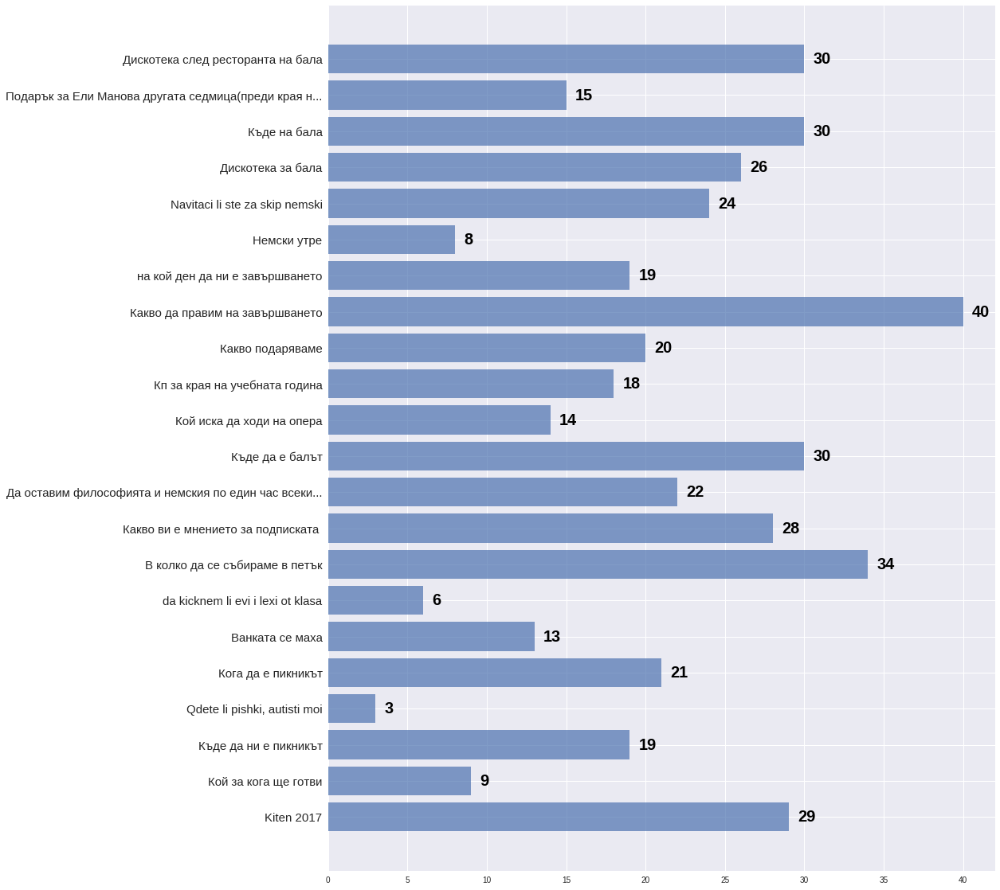

In [0]:
texts = data.loc[data['text'].notnull()] 
textsWithCreated = texts.loc[texts['text'].str.contains('created')]['text'].tolist()
textsWithCreated = [t.split('poll: ')[1][:-1] for t in textsWithCreated if 'poll: ' in t]

polls = {}

textsWithVoted = texts.loc[texts['text'].str.contains('voted')]['text'].tolist()
textsWithVoted = [t.split('poll: ')[1][:-1] for t in textsWithVoted if 'poll: ' in t]

for p in textsWithCreated:
  
  for v in textsWithVoted:
    if p in v:
      if p in polls:
        polls[p]+=1
      else:
        polls[p]=1

fig = plt.figure(5)
fig.set_size_inches(15,20)
fig.tight_layout()
ax = fig.subplots()

ylabels = polls.values()
ylabels = [p if len(p)<50 else p[:50]+'...' for p in list(polls.keys())]

ax.barh(range(len(polls)), list(polls.values()), align='center', alpha=0.7)
ax.set(yticks=range(len(polls)))
ax.set_yticklabels(ylabels, fontsize=15)

y = list(polls.values())
for i, v in enumerate(y):
  ax.text(v+(max(y)/70), i, str(round(v,2)), color='Black', fontweight='bold', verticalalignment='center', fontsize=20)

plt.show()

#Absurdism
<font size='3'></font>

##From language to math
Machines, unlike humans, are not good with linguistics but they do excel at math. Here are a few functions which will help us in converting the gibberish presented in the groupchat to something more understandable for the algorithm - a vector. You know the drill by now - from top to bottom:


*   get_clear_sentences(): Takes in a string and returns an array of aphabetic sentances. That means no emojis, hieroglyphs, cyrillics, punctuation and numbers. It also lowers every capitalized character.
*   remove_rare_chars(): Removes characters which are used less than *n* times.
*   wordToVec(): This is where the magic happens and where some of those imports we had in the begining come in handy. It takes the words and assigns a vector to each of them. Those vectors are supposed to represent the meaning of the word, which means that words with similar meanings will be close in the vector space. It does that by looking at a small window around the given word which gives it context. Of course this is all  <a href='https://en.wikipedia.org/wiki/Word2vec'>extremely simplified</a> and I am using an already written library instead of doing it myself.
*   query(): Takes in a word and returns the *n* closest words in the vector space.



In [0]:
def get_clear_sentences(doc):
  doc = doc.splitlines()
  sentences = []
  for line in doc:
    tokens = line.split()
    table = str.maketrans('', '', string.punctuation)
    tokens = [w.translate(table) for w in tokens]
    tokens = [word for word in tokens if word.isalpha()]
    tokens = [word.lower() for word in tokens]
    if(len(tokens)!=0):sentences.append(list(tokens))
  return sentences

def remove_rare_chars(text,threshold):
  temp = dict()
  cleanText = []
  for c in text:
    if c in temp:
      temp[c] += 1
    else:
      temp[c] = 1
  for c in text:
    if temp[c] < threshold and not c.isalpha() : continue
    else: cleanText.append(c)
  text = ''.join(cleanText)
  text = re.sub(' +', ' ', text)
  text = "\n".join([ll.rstrip() for ll in text.splitlines() if ll.strip()])
  return text

def wordToVec(text, window = 10, epochs = 50, size = 50, padding = False):
  sentences = get_clear_sentences(text)
  if(padding):
    for i,s in enumerate(sentences):
      if(len(s) < window):
        k = window-len(s)
        sentences[i] = ['extend' for i in range(round(k/2))] + s + ['extend' for i in range(round(k/2))]
  print(sentences[:10])
  model = gensim.models.Word2Vec(
        sentences,
        size=size,
        window=window,
        min_count=5,
        workers=10)
  model.train(sentences, total_examples=len(sentences), epochs=epochs)
  model.save('mymodel')
  
def query(word):
  model = gensim.models.word2vec.Word2Vec.load('mymodel')
  print(word + " -> ", end='')
  ms = model.wv.most_similar(word,topn=5)
  for w,v in ms:
    print(w,end='|')
  print('')

In [0]:
numDim = 100
#text = getTextFromUser(['Alex Savova','Svilen Kirov','Elitsa Ilieva','Alex Ivanova','Жаклин Ковачева','Лилия Димитрова','Димитрина Гърчева','Виктория Драгоманова'])

#text = getTextFromUser([])
#text = remove_rare_chars(text,75)

wordToVec(text, window=2, epochs=25, size=numDim, padding = False)

[['a', 'spomenite', 'ot', 'starata', 'grupa'], ['jertvame', 'gi', 'v', 'polza', 'na', 'kolektiva', 'kirev', 'e', 'vinoven'], ['nqkoy', 'ot', 'shkolata', 'kakvo', 'pravite'], ['warten'], ['i', 'iskate', 'li', 'da', 'doyde', 'nqkoy', 'da', 'me', 'vzeme', 'i', 'vylkova', 'doshla', 'li', 'e'], ['ot', 'chasa', 'li'], ['mhm'], ['black', 'widow', 'set', 'the', 'emoji', 'to'], ['moje', 'li', 'koito', 'e', 'v', 'chas', 'kato', 'svurshi', 'chasa', 'i', 'alexabdrov', 'si', 'trugne', 'da', 'proveri', 'dnevnika', 'ocenkite', 'po', 'mat', 'i', 'da', 'gi', 'snima', 'srochni', 'sip', 'i', 'zp'], ['zashto', 'e', 'bqlo']]


##The spectrum of laughter
![alt text](https://drive.google.com/uc?id=1vhmyHzZ4oIKHinU6JRkHJ-v_qn3UR5Fr)<br/>
I love how the sentiment surrounding the laughter slowly gets worse and worse as the number of '*ha*'-s increase and for some reason 'hahahahaha' is strongly related to coughing. Also apperantly Kircho is not a person in our chat's eyes but rather a subject. Also also, the different meanings of 'Tuncheva' are readily apparent here.

In [0]:
query('pesheva')
query('coneva')
query('tuncheva')
query('sashko')
query('kircho')
print('')

query('ha')
query('haha')
query('hahaha')
query('hahahaha')
query('hahahahaha')
query('hahahahahaha')
query('hahahahahahaha')
query('hahahahahahahaha')
query('hahahahahahahahaha')

print('')
query('srqda')
query('lv')
query('mat')


pesheva -> zangocheva|tunchaka|tuncheva|diskoteka|vulkova|
coneva -> martina|tunchaka|anubis|deleva|lesen|
tuncheva -> sashko|vylkova|zangocheva|vulkova|pesheva|
sashko -> vulkova|tunchaka|tuncheva|iliev|sneji|
kircho -> geo|bel|tunchi|mat|biologiq|

ha -> battle|oformi|himia|deutsch|kontra|
haha -> ee|ujas|autocorrect|merci|brao|
hahaha -> deee|hahahah|hahah|puskayte|speshial|
hahahaha -> mbt|desen|thanks|kolelo|harry|
hahahahaha -> kashlqm|thanks|topaaa|evalata|relatable|
hahahahahaha -> begi|umri|both|damn|ppl|
hahahahahahaha -> yanaki|hahahahaha|hahahahahaha|umira|hahahahahahahaha|
hahahahahahahaha -> tiltnah|tashak|izglejdam|tru|vsekigo|
hahahahahahahahaha -> fucking|only|soccer|boot|reaccs|

srqda -> chetvyrtyk|petyk|ponedelnik|sybota|nedelq|
lv -> leva|kaparo|kinta|pari|deklaracii|
mat -> bel|fizika|geo|literatura|matematika|


##Superficial
I have no joke spent about 12 hours on the next few cells. Not only do they take a ton of time to run, but the algorithms I have used here also have a ton of the <br/>so-called hyperparameters, which require a lot of tuning. So what does getTransformed() do, you ask? Well, simple - it takes the n dimensional vector of the word and compresses it into two dimensions. Imagine trying to draw a cube or a tesseract but you only have a line as your canvas. Some difficulties emerge. For example each point is evenly spaced from 3 or 4 other points, but they themselves are not evenly spaced from eachother. You must somehow put them at some distance from the first point but at another from eachother. After that recursively do that for each point. It's clearly impossible. Some information is bound to be lost. Of course some clever people have tackled this problem and thought of some brilliant solutions. I won't explain them here partly because it would take too long and partly because I don't fully understand them. Here are some simple explanations I found instead. 


*   <a href='https://www.reddit.com/r/explainlikeimfive/comments/17xk21/eli5_principle_component_analysis_pcn/c89rmai/'>Principal component analysis</a>
*   <a href='https://nlml.github.io/in-raw-numpy/in-raw-numpy-t-sne/'>t-distributed Stochastic Neighbor Embedding</a>
*   <a href='https://www.quora.com/What-is-the-Isomap-algorithm'>Isomap Embedding</a>
*   <a href='https://towardsdatascience.com/spectral-clustering-for-beginners-d08b7d25b4d8'>Spectral embedding</a>
*   <a href='https://www.statisticshowto.datasciencecentral.com/multidimensional-scaling/'>Multidimensional scaling</a>
*   <a href='https://towardsdatascience.com/classification-part-2-linear-discriminant-analysis-ea60c45b9ee5'>Linear Discriminant Analysis</a>

But you know what I have? The magic word 'Import'. <br/>
Next we have the removeOutliers() function. This is pretty straight forward. Using a oneclass svm remove the outliers from the now reduced vectors. This is so that we don't have any anomalies in our dataset, which might worsen the quality of the outputted plot by stretching it too far.<br/>
And lastly we have makeClusters() which takes in the non-reduced(the original) vectors and clusters them. This is so that even when we lose a lot of the information we preserve some by looking at the color coded clusters. Remember - members of a specific cluster must be close to eachother in the n-dimension, so if the look far away in the plot it must be because of the lost variance.

In [0]:
def getTransformed(embedder, **kwargs):
  model = gensim.models.word2vec.Word2Vec.load('mymodel')
  words = []
  for w in model.wv.vocab:
    words.append(model.wv.get_vector(w))

  wordsTransformed = []

  if embedder == 'pca':
    pca = PCA(n_components=2, svd_solver='auto')
    wordsTransformed = pca.fit_transform(words)
    print(pca.explained_variance_ratio_)

  if embedder == 'tsne':
    tsne = TSNE(n_components=2, verbose=1, perplexity=kwargs['perplexity'], n_iter=kwargs['n_iter'], early_exaggeration=kwargs['exaggeration'])
    wordsTransformed = tsne.fit_transform(words)

  if embedder == 'iso':
    iso = Isomap(n_neighbors=2, neighbors_algorithm='ball_tree', n_components=2)
    wordsTransformed = iso.fit_transform(words)
    
  if embedder == 'spectral':
    spec = SpectralEmbedding(n_components=2)
    wordsTransformed = spec.fit_transform(words)

  if embedder == 'mds':
    mds = MDS(n_components=2)
    wordsTransformed = mds.fit_transform(words)
  
  if embedder == 'lda':
    lda = LinearDiscriminantAnalysis(n_components=2)
    wordsTransformed = lda.fit(words, kwargs['wordsY']).transform(X)
  
  if embedder == 'none':
    wordsTransformed = words
    
  return wordsTransformed

def removeOutliers(wordsTransformed,remove = True,nu=0.5):
  if remove == False:
    inliers = [1 for i in range(len(wordsTransformed))]
    return wordsTransformed,inliers
  clf = svm.OneClassSVM(nu=nu, kernel="rbf", gamma='auto',)
  inliers = clf.fit_predict(wordsTransformed)
  wordsTransformed = [w for i,w in enumerate(wordsTransformed) if inliers[i]==1]
  return (wordsTransformed,inliers)

def makeClusters(words = None, num_clusters = 8, elbow = False):
  if words == None:
    model = gensim.models.word2vec.Word2Vec.load('mymodel')
    words = []  
    for w in model.wv.vocab:
      words.append(model.wv.get_vector(w))  
  
  if elbow:
    nc = range(1,20)

    kmeans = [KMeans(n_clusters=i) for i in nc]
    score = [kmeans[i].fit(words).score(words) for i in range(len(kmeans))]
    
    p1 = np.array([nc[0],score[0]])
    p2 = np.array([nc[-1],score[-1]])
    maxi, maxX = 0,0
    for x in nc:
      y = score[x-1]
      p3 = np.array([x,y])
      d = np.abs(np.cross(p2-p1, p1-p3)) / np.linalg.norm(p2-p1)
      print(d)
      if d > maxi:
        maxi = d
        maxX = x
    
    print('Optimal clusters: {}'.format(maxX))
    
    plt.plot(nc,score)
    plt.xlabel('Number of Clusters')
    plt.ylabel('Score')
    plt.title('Elbow Curve')
    plt.scatter(maxX,score[maxX-1],c='r')
    plt.show()
   
  
  clusters = KMeans(n_clusters = num_clusters, init = 'k-means++', n_init = 20).fit(words)
  
  return clusters.labels_

Now that we have our data, we must somehow plot it. The problem is that the data is massive. About 4000 words even after removing a lot of them (words used less than 10 times, stopwords and anything which is not purely alphabetic). I have no clear solutions except 'plot only some words'. Also I have written and rewritten this functions so many times it became nigh unreadable except for higherdimensional beings.

In [0]:
def plotEmbeddedWords(addText = True, *args, **kwargs):
  print('Constructing clusters. . .')
  clusters = makeClusters(None,5,False)
  
  print('Reducing dimensionality. . .')
  model = gensim.models.word2vec.Word2Vec.load('mymodel')
  wordsTransformed = getTransformed(embedder = kwargs['embedder'], perplexity = kwargs['perplexity'], n_iter = kwargs['n_iter'], exaggeration = kwargs['exaggeration'], wordsY = clusters)
  
  print('Removing outliers. . .')
  wordsTransformed, inliers = removeOutliers(wordsTransformed,remove=True,nu=0.1)

  custom_colors = {0:'deepskyblue',1:'springgreen',2:'violet',3:'y',4:'lightsalmon',5:'r',6:'c'}
  clusters = [custom_colors[c] for i,c in enumerate(clusters) if inliers[i]==1]

  realInd = np.zeros((len(inliers)))
  br = 0
  for i in range(len(inliers)):
    if inliers[i] == 1:
      realInd[i] = br
      br+=1;
  x, y = zip(*wordsTransformed)
  fig = plt.figure(1)
  if 'big' in args:
    fig.set_size_inches(50, 35)
    plt.scatter(x,y,alpha=0.65,cmap=plt.get_cmap('brg'),c=clusters,s=120)
  else:
    fig.set_size_inches(25, 15)
    plt.scatter(x,y,alpha=0.65,cmap=plt.get_cmap('brg'),c=clusters)
  
  clusterCounter = {}
  clusterSize = {}
  for i in range(len(inliers)):
    if(inliers[i]==-1):
      continue
    ri = int(realInd[i])
    if(clusters[ri] not in clusterCounter):
      clusterCounter[clusters[ri]] = 1
    if(clusters[ri] in clusterSize):
      clusterSize[clusters[ri]] += 1
    else:
      clusterSize[clusters[ri]] = 1

  if addText:
    print('Plotting words. . .')
    wordStr = []
    permitted = ['vankata','vanka','lili','elitsa','hristov','barbov','sashko','alexandrov','valdi','vladi','leva','lv','kircho','kirev','tuncheva','mat','matematika','bel','istoriq','informatika','savova','martinka','vylkova','vulkova','pari',
                'teatyr','evi','svilen','eli','ponedelnik','vtornik','srqda','chetvyrtyk','geo','geografiq','petyk','sneji','deni','kontrolno','zakysnqvam','lyuben','alex','viki','dom','dr','domashno','joro','jorj','gay','mirchev','alexandyr','yo',
                 'koprivlenska','gei','kapi','momchi','kur','cici','ivan','lachev','rado','bate','ok','boi','ebem','sex','sladka','cute','girl','never','bring','us','down','alexander','liliq','until','hour','plan','started','snimka','pesheva',
                 'uchitel','tq','mama','prepodava','ive','bobka','martina','qnakiev','radina','ushagelov','pet','joined','svyrshena','vakanciq','napomnq','krayniqt','srok','sybirame']
    for i,w in enumerate(model.wv.vocab):
      if(inliers[i]==-1):
        continue
      ri = int(realInd[i])
      if(w in permitted):
        wordStr.append((w,ri))
        continue
      closeW = model.wv.most_similar(w,topn=15)
      if any(cw in permitted for cw,v in closeW):
        wordStr.append((w,ri))
        continue
      if clusterCounter[clusters[ri]] < clusterSize[clusters[ri]]/5:
        clusterCounter[clusters[ri]] += 1
        wordStr.append((w,ri))

    print('Adjusting overlapping text (This may take awhile). . .')
    texts = [plt.text(x[t[1]], y[t[1]], '%s' %t[0], fontsize = 12) for i,t in enumerate(wordStr)]
    print(str(adjust_text(texts,lim=40,arrowprops=dict(arrowstyle='->', color='red'))))  
  plt.show()
  fig.savefig('gdrive/My Drive/Graphs/tsne{}.svg'.format(str(kwargs["perplexity"])+"_"+str(kwargs["exaggeration"])))
  fig.savefig('gdrive/My Drive/Graphs/tsne{}.png'.format(str(kwargs["perplexity"])+"_"+str(kwargs["exaggeration"])))  

By this point, you are probably sleeping, but I promise this is the last boring part! This is called the elbow method, because of the shape. It shows us where the tradeoff between lost variance and number of clusters is the best. 

0.0
3.22122743877722
5.324181991463671
6.2245356053588585
6.499915304709543
6.486281101920337
6.405756839266602
6.067829504580024
5.723920084923581
5.326552177623491
4.734509785758279
4.274915125487421
3.662000980006375
3.180644152921557
2.497761290090817
1.698931841710881
1.1422533701459279
0.6926156572980547
0.0
Optimal clusters: 5


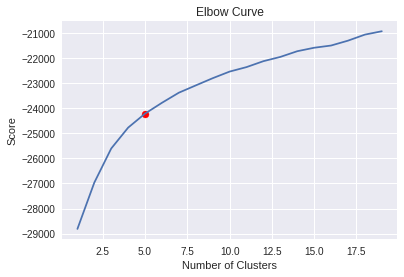

array([2, 6, 0, ..., 2, 2, 2], dtype=int32)

In [0]:
makeClusters(words = None, num_clusters = 8, elbow = True)

Ok, now I run a bunch of tests, basically throwing mud at the wall and seeing what sticks. I will quickly run through the parameters:

1.   embedder - the type of embedder. I have tried all of them and the most promising one was T-SNE.
2.   perplexity - the number of neighbours T-SNE will take into account.
3.   n_iter - number of iterations T-SNE will run for.
4.   exaggeration - How exaggerated the distance between the members in the clusters in the begining will be.



Gen 0...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 12.983s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.745276
[t-SNE] KL divergence after 250 iterations with early exaggeration: 25.702087
[t-SNE] KL divergence after 500 iterations: 3.576434
Removing outliers. . .


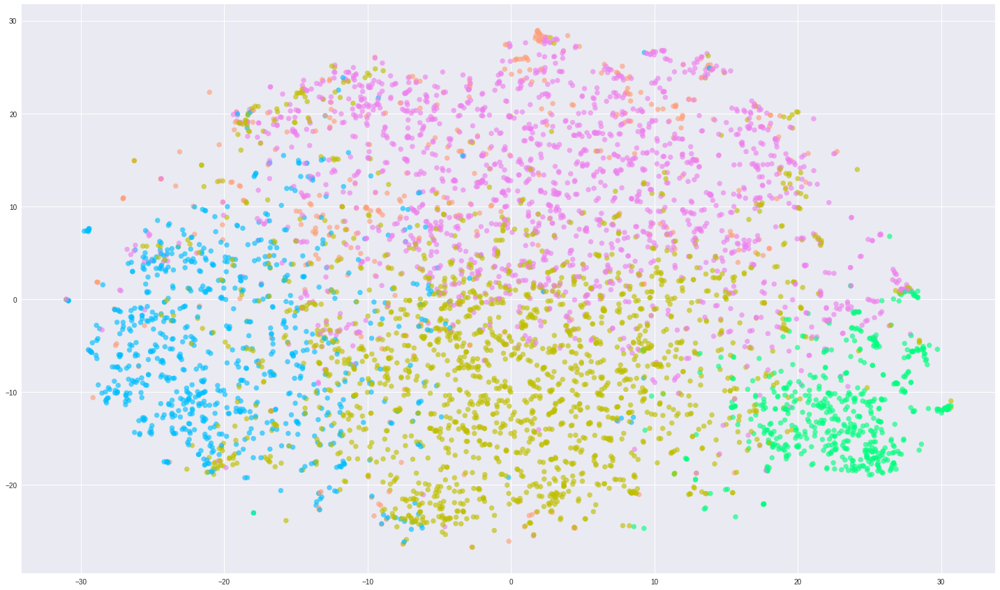

Gen 1...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.300s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.797966
[t-SNE] KL divergence after 250 iterations with early exaggeration: 24.439445
[t-SNE] KL divergence after 500 iterations: 3.424746
Removing outliers. . .


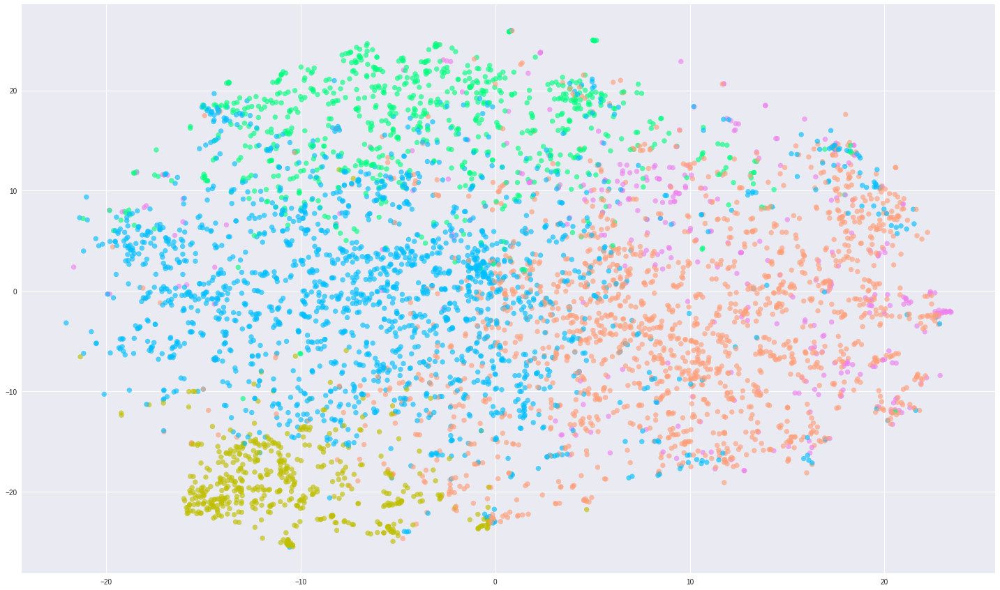

Gen 2...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.026s...
[t-SNE] Computed neighbors for 7761 samples in 13.354s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.835009
[t-SNE] KL divergence after 250 iterations with early exaggeration: 23.288979
[t-SNE] KL divergence after 500 iterations: 3.301862
Removing outliers. . .


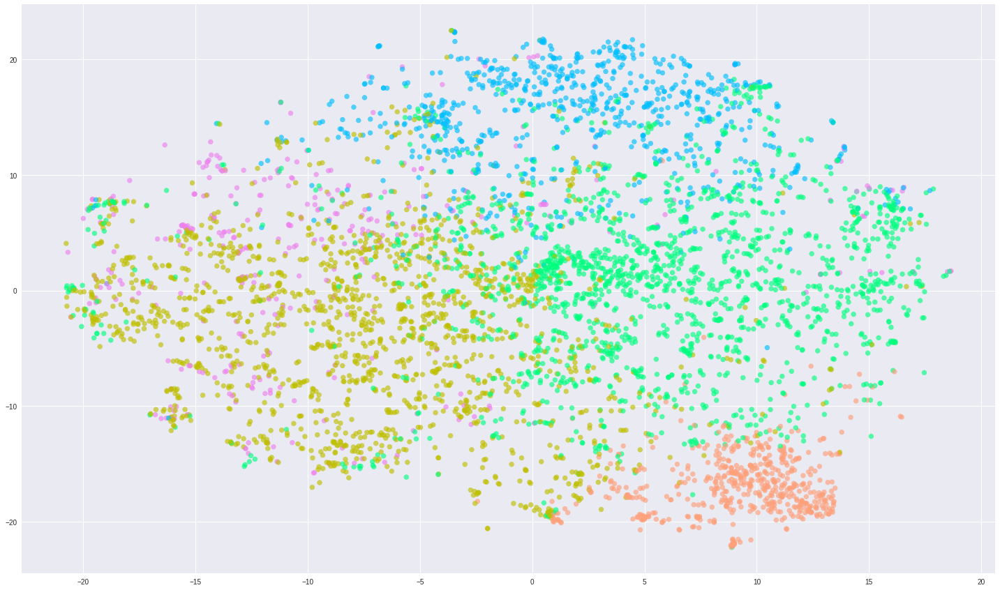

Gen 3...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.196s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.863779
[t-SNE] KL divergence after 250 iterations with early exaggeration: 22.654844
[t-SNE] KL divergence after 500 iterations: 3.180017
Removing outliers. . .


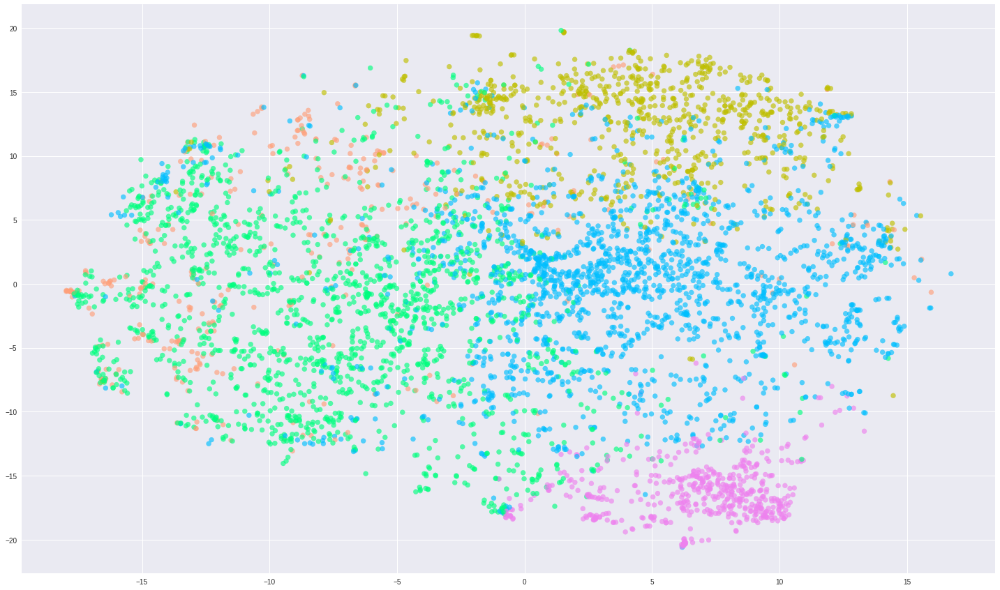

Gen 4...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 181 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.514s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.887399
[t-SNE] KL divergence after 250 iterations with early exaggeration: 21.694071
[t-SNE] KL divergence after 500 iterations: 3.078177
Removing outliers. . .


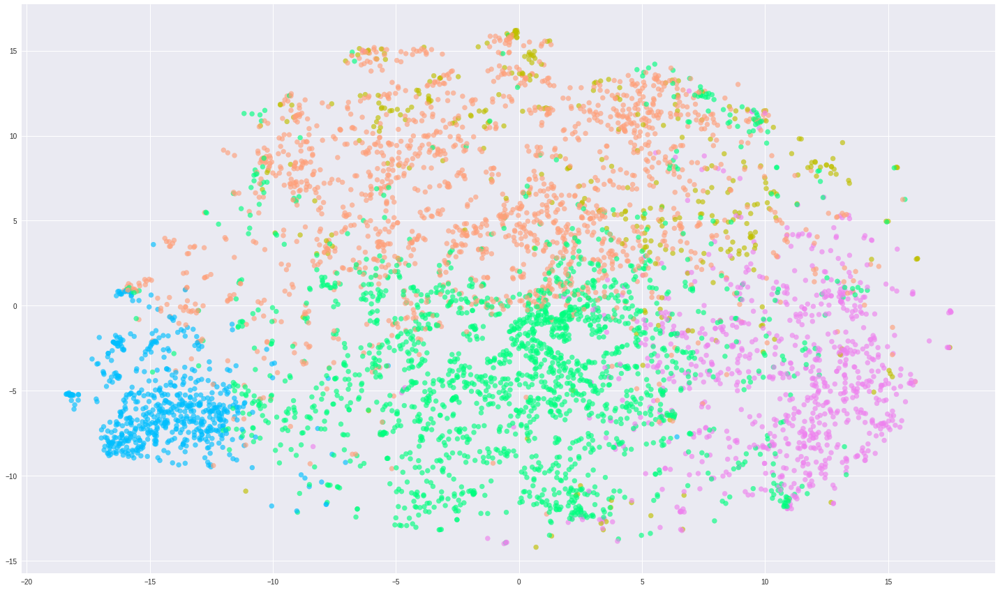

Gen 5...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.292s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.907503
[t-SNE] KL divergence after 250 iterations with early exaggeration: 21.195002
[t-SNE] KL divergence after 500 iterations: 3.021375
Removing outliers. . .


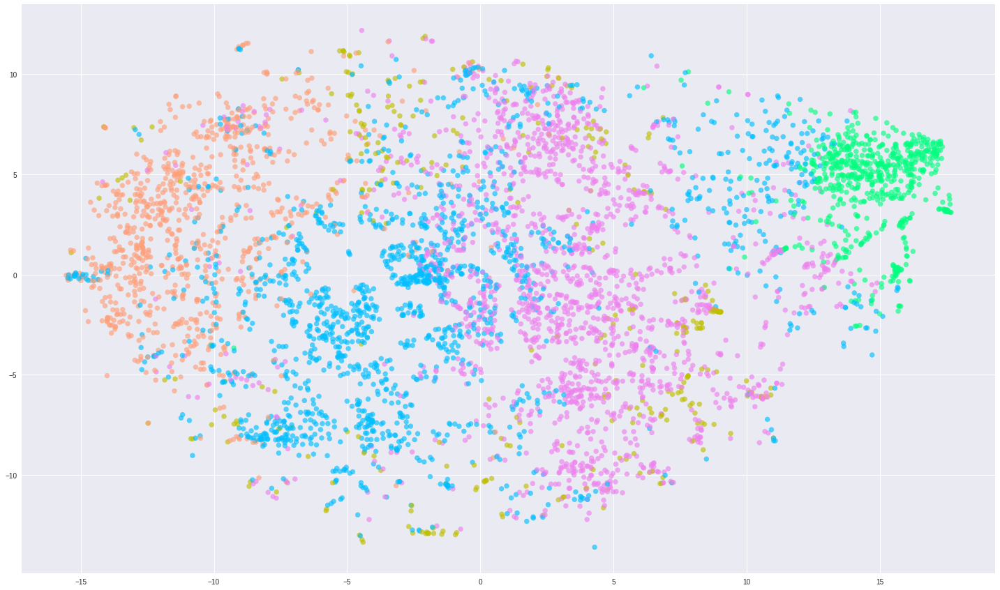

Gen 6...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.035s...
[t-SNE] Computed neighbors for 7761 samples in 13.695s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.925057
[t-SNE] KL divergence after 250 iterations with early exaggeration: 20.620127
[t-SNE] KL divergence after 500 iterations: 2.906163
Removing outliers. . .


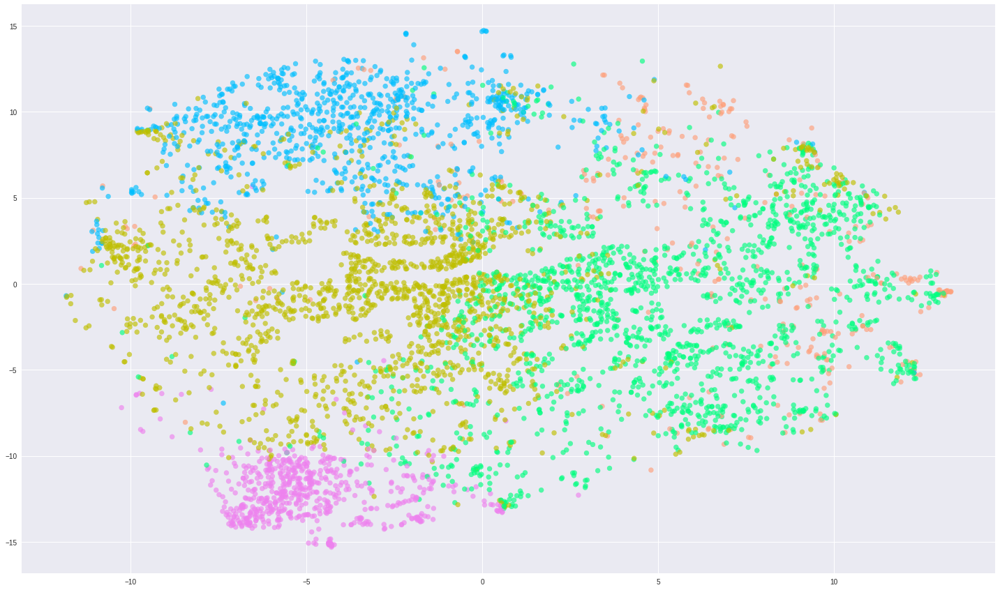

Gen 7...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 271 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.507s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.940666
[t-SNE] KL divergence after 250 iterations with early exaggeration: 20.177055
[t-SNE] KL divergence after 500 iterations: 2.830519
Removing outliers. . .


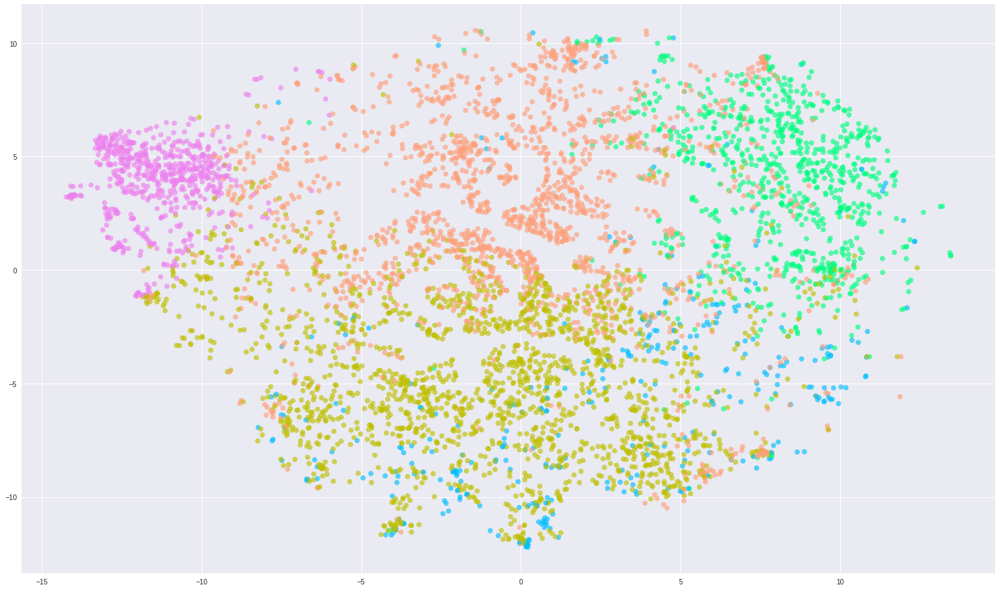

Gen 8...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.904s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.954755
[t-SNE] KL divergence after 250 iterations with early exaggeration: 19.823713
[t-SNE] KL divergence after 500 iterations: 2.763173
Removing outliers. . .


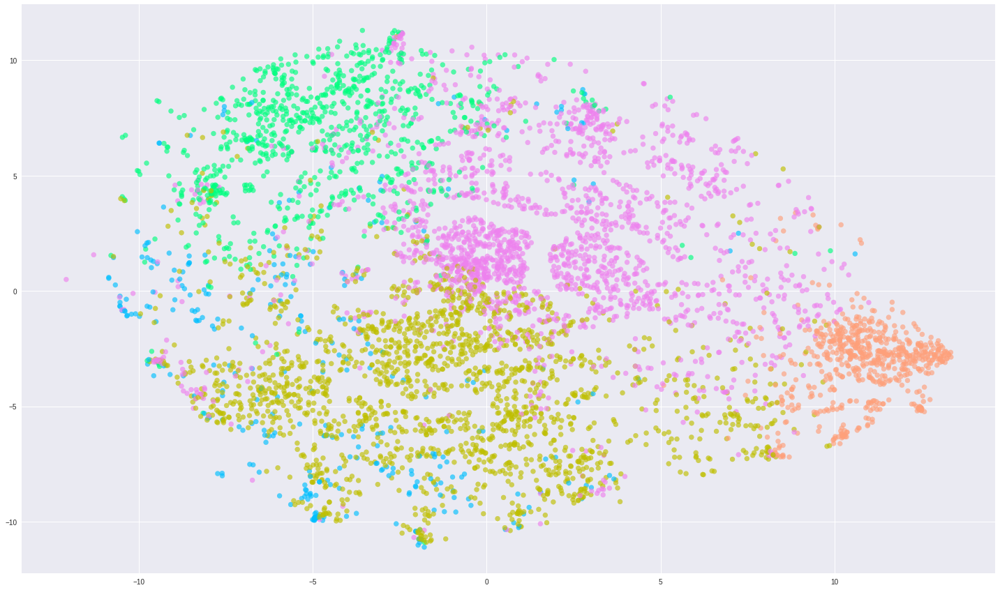

Gen 9...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 331 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.711s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.967617
[t-SNE] KL divergence after 250 iterations with early exaggeration: 19.444845
[t-SNE] KL divergence after 500 iterations: 2.703582
Removing outliers. . .


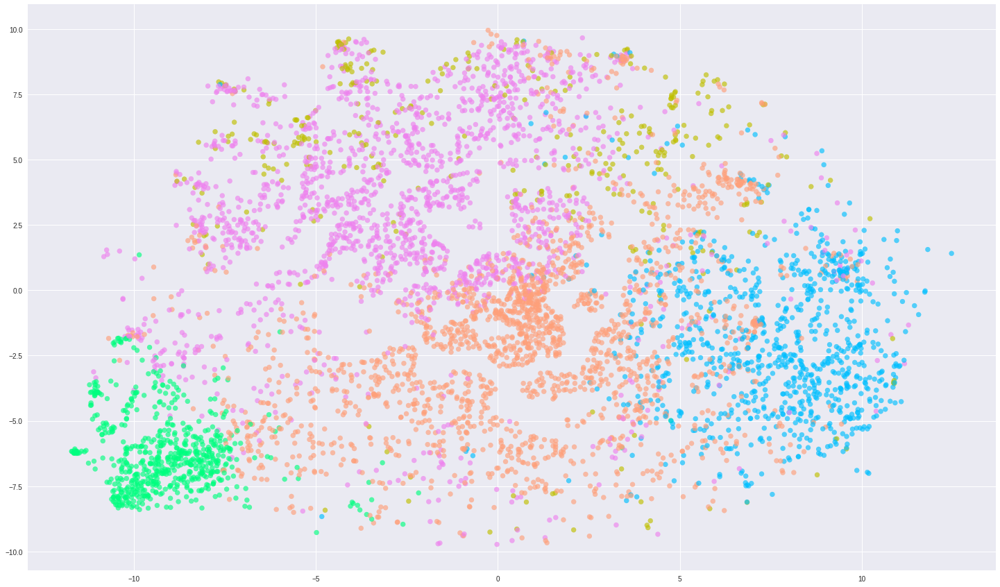

Gen 10...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 451 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 14.293s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.010439
[t-SNE] KL divergence after 250 iterations with early exaggeration: 18.225569
[t-SNE] KL divergence after 500 iterations: 2.484717
Removing outliers. . .


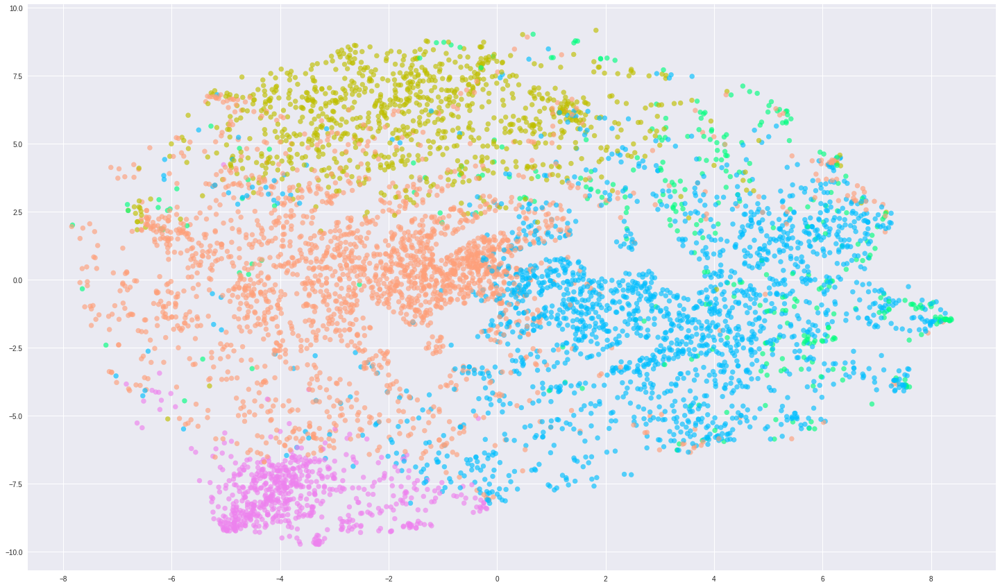

Gen 11...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 901 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.026s...
[t-SNE] Computed neighbors for 7761 samples in 15.115s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.114392
[t-SNE] KL divergence after 250 iterations with early exaggeration: 15.526884
[t-SNE] KL divergence after 500 iterations: 2.048836
Removing outliers. . .


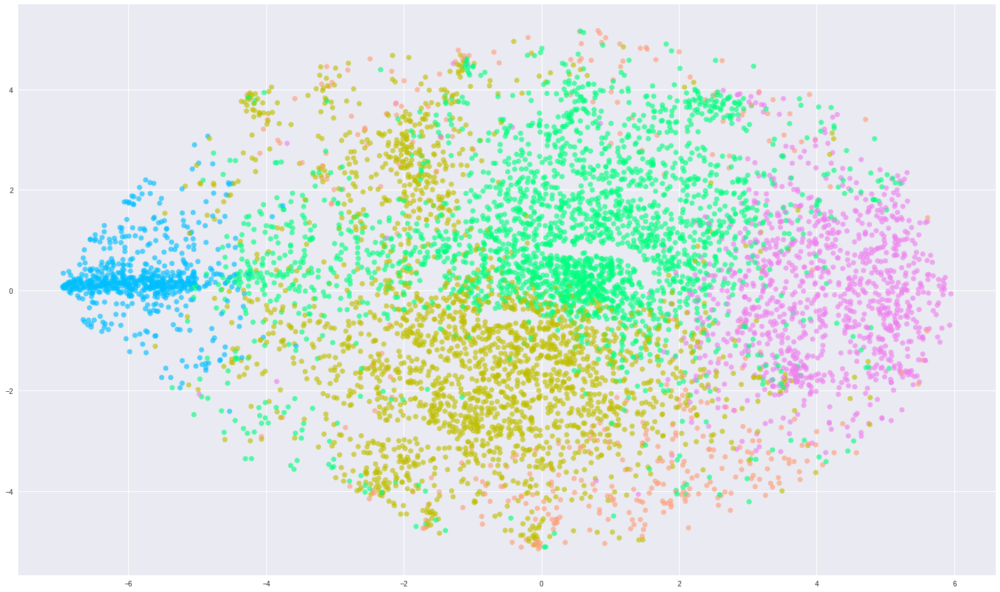

Gen 12...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 1501 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 16.731s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.203864
[t-SNE] KL divergence after 250 iterations with early exaggeration: 13.570924
[t-SNE] KL divergence after 500 iterations: 1.648669
Removing outliers. . .


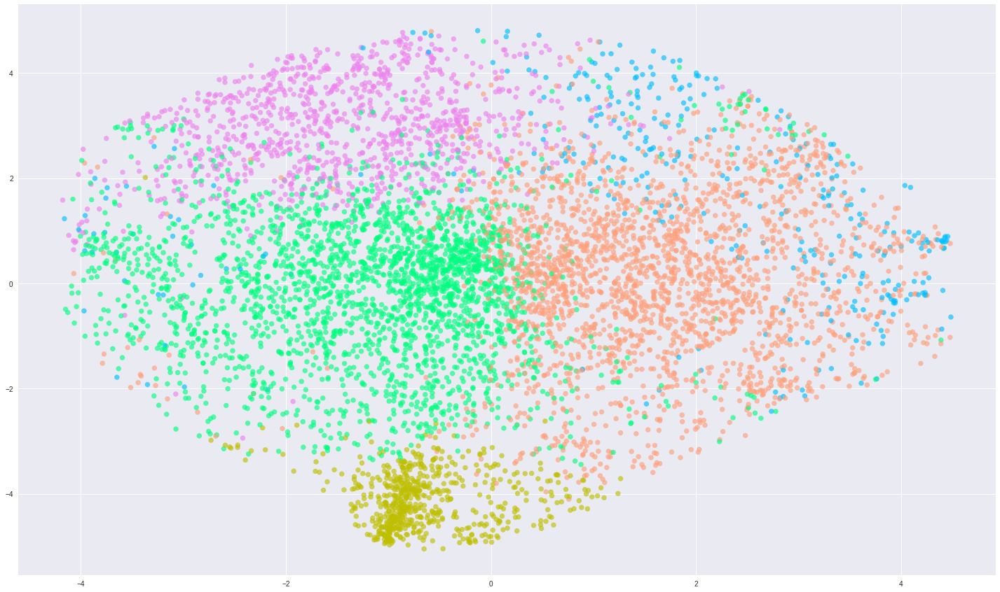

Gen 13...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 12.983s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.745276
[t-SNE] KL divergence after 250 iterations with early exaggeration: 104.216507
[t-SNE] KL divergence after 500 iterations: 3.714385
Removing outliers. . .


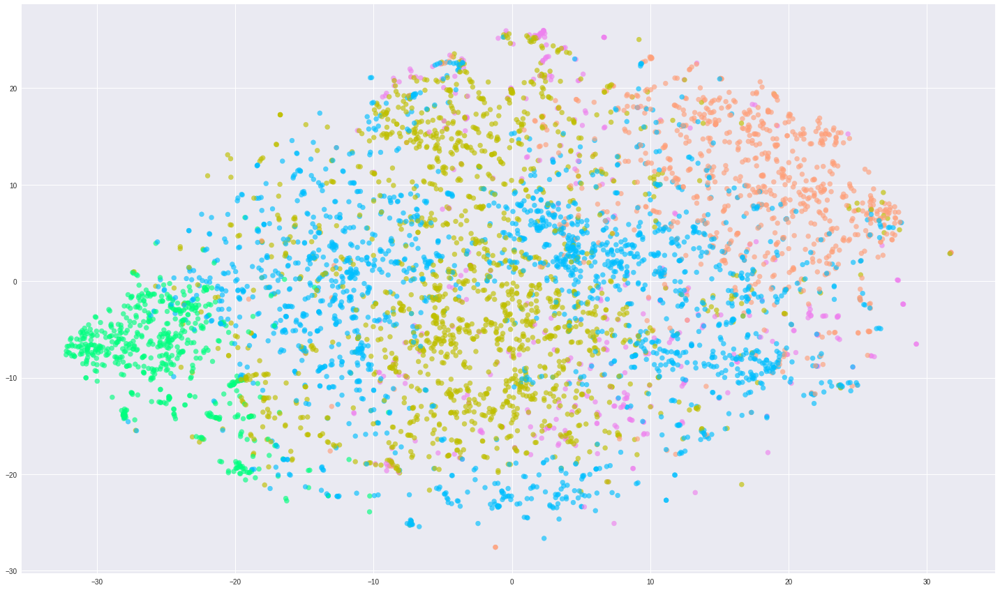

Gen 14...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.065s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.797966
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.189156
[t-SNE] KL divergence after 500 iterations: 3.512023
Removing outliers. . .


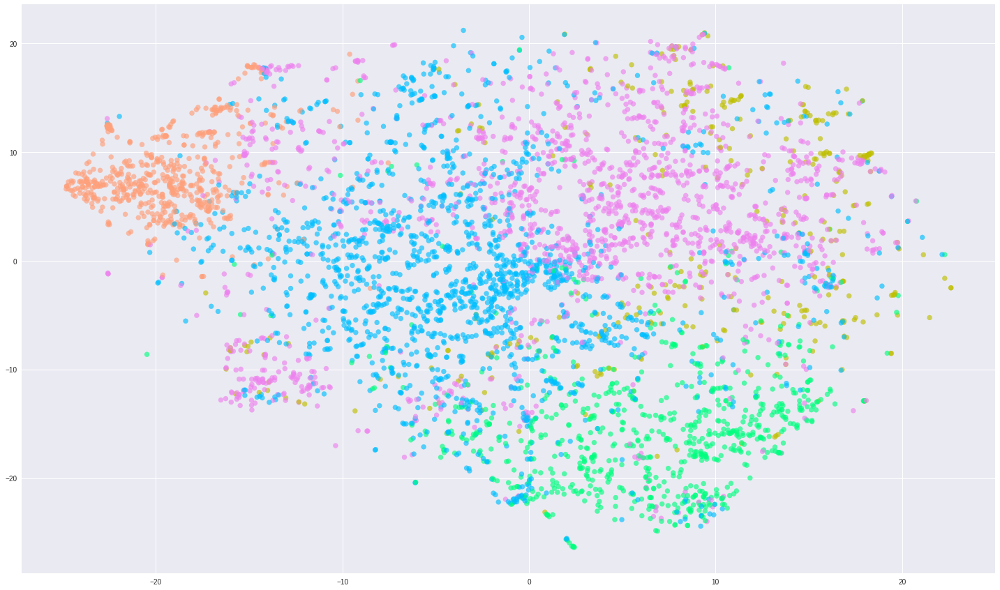

Gen 15...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.026s...
[t-SNE] Computed neighbors for 7761 samples in 13.486s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.835009
[t-SNE] KL divergence after 250 iterations with early exaggeration: 96.581604
[t-SNE] KL divergence after 500 iterations: 3.378422
Removing outliers. . .


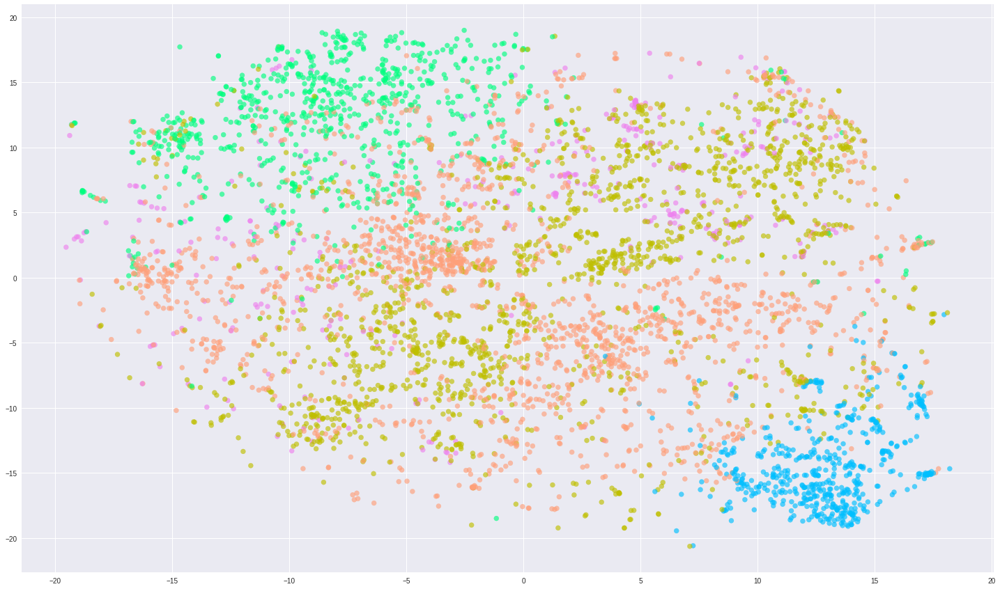

Gen 16...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 151 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.254s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.863779
[t-SNE] KL divergence after 250 iterations with early exaggeration: 91.972977
[t-SNE] KL divergence after 500 iterations: 3.222558
Removing outliers. . .


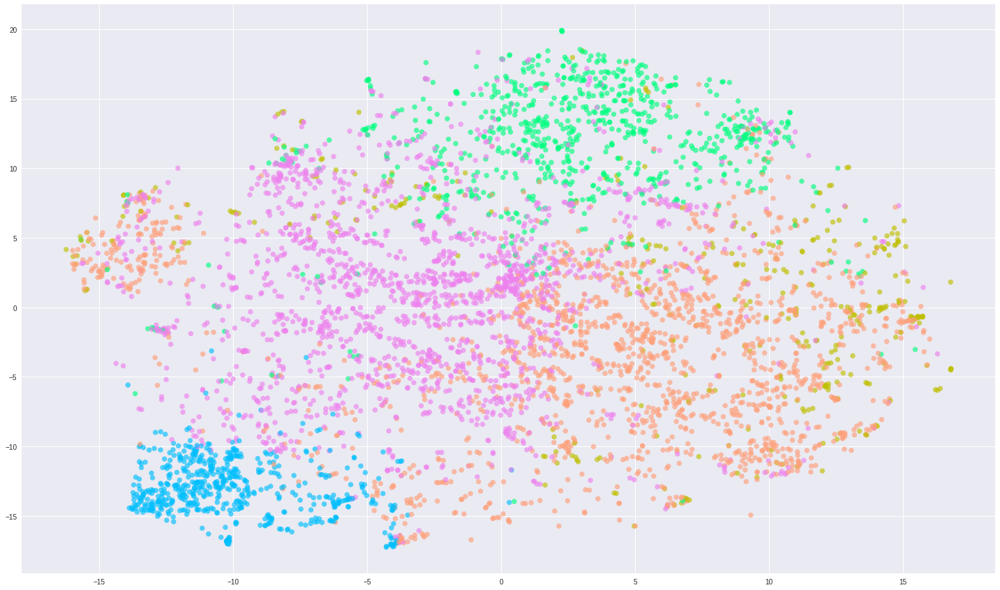

Gen 17...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 181 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.447s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.887399
[t-SNE] KL divergence after 250 iterations with early exaggeration: 90.665138
[t-SNE] KL divergence after 500 iterations: 3.095252
Removing outliers. . .


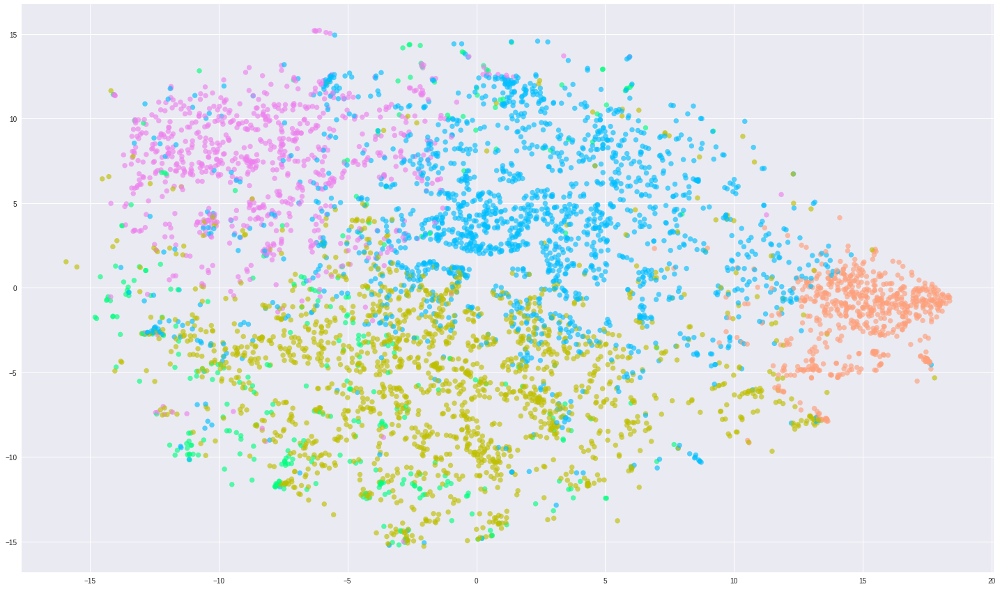

Gen 18...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.399s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.907503
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.217079
[t-SNE] KL divergence after 500 iterations: 3.004129
Removing outliers. . .


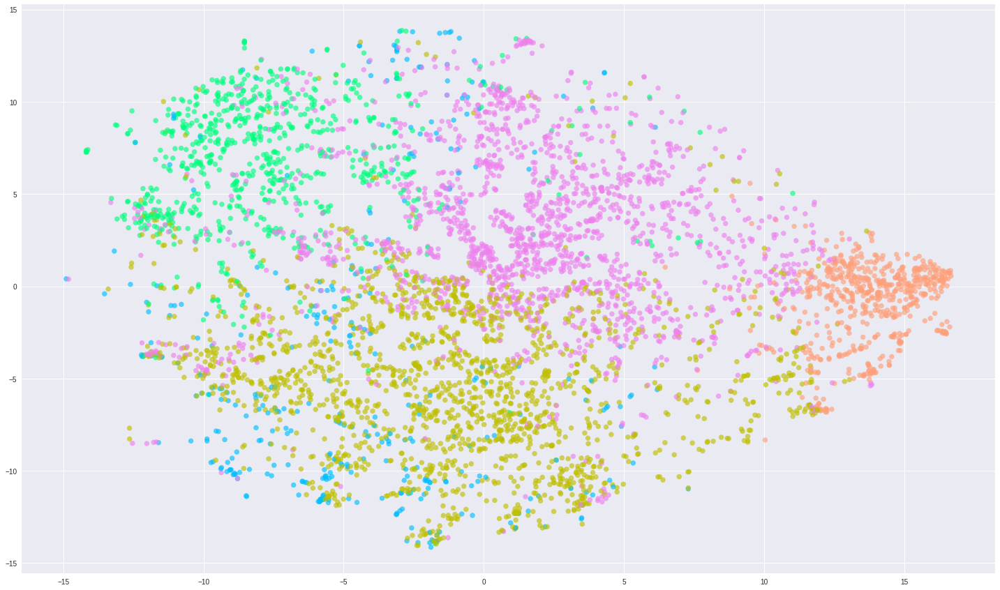

Gen 19...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 241 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 13.769s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.925057
[t-SNE] KL divergence after 250 iterations with early exaggeration: 87.530823
[t-SNE] KL divergence after 500 iterations: 2.947632
Removing outliers. . .


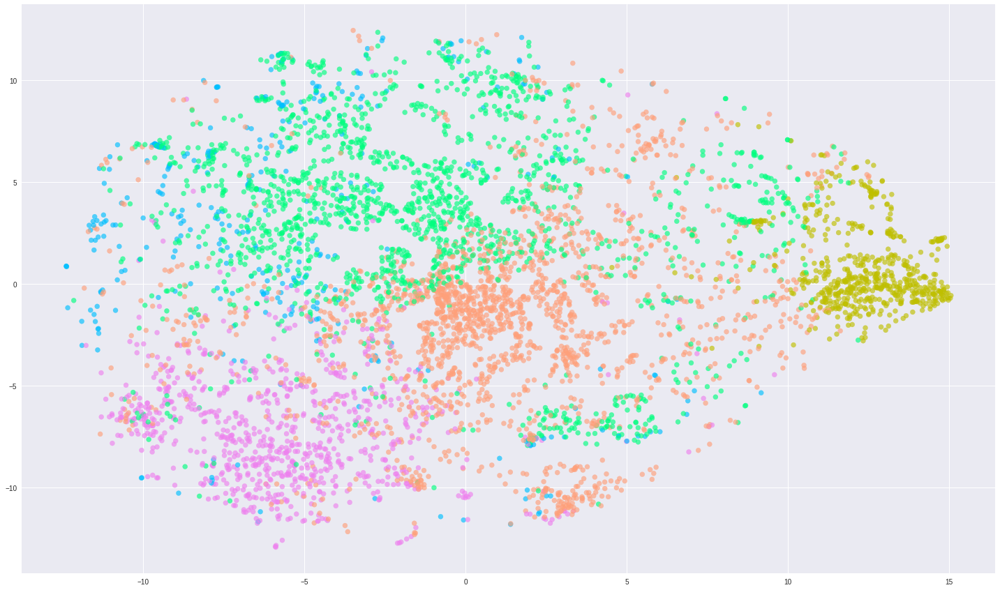

Gen 20...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 271 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.565s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.940666
[t-SNE] KL divergence after 250 iterations with early exaggeration: 85.719276
[t-SNE] KL divergence after 500 iterations: 2.889015
Removing outliers. . .


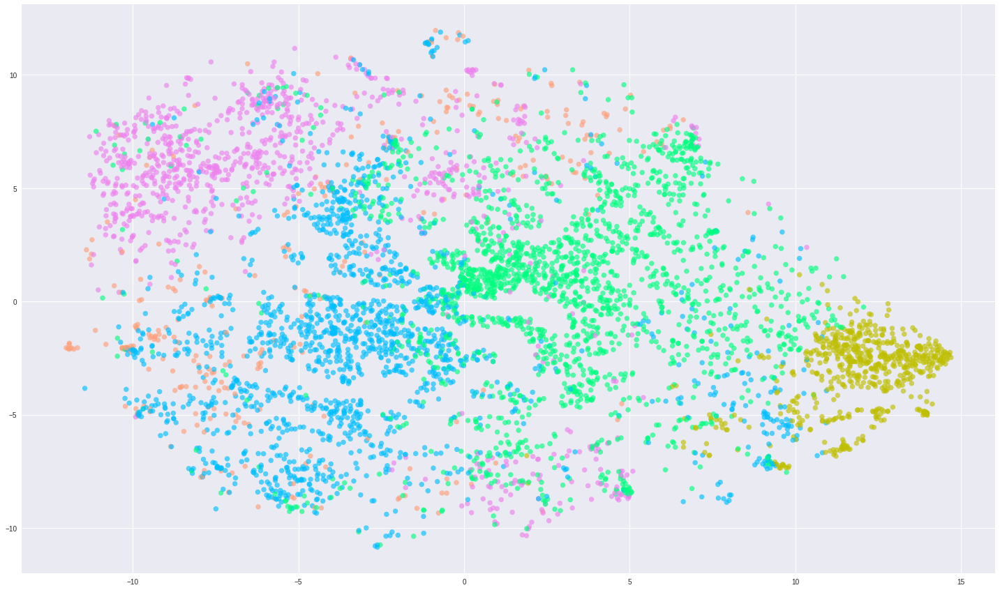

Gen 21...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.885s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.954755
[t-SNE] KL divergence after 250 iterations with early exaggeration: 81.840385
[t-SNE] KL divergence after 500 iterations: 2.820913
Removing outliers. . .


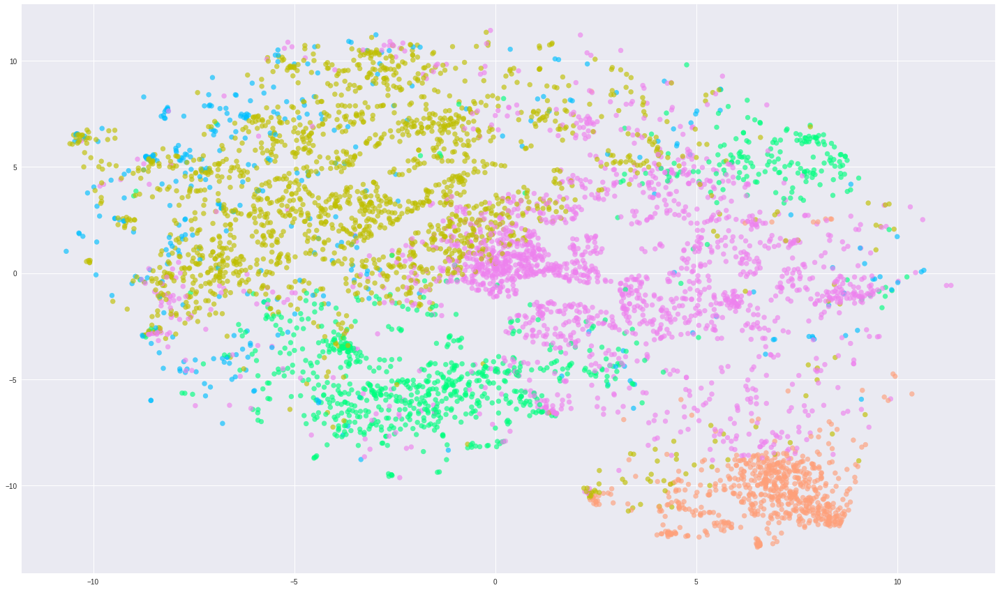

Gen 22...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 331 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 13.622s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 0.967617
[t-SNE] KL divergence after 250 iterations with early exaggeration: 80.108101
[t-SNE] KL divergence after 500 iterations: 2.790054
Removing outliers. . .


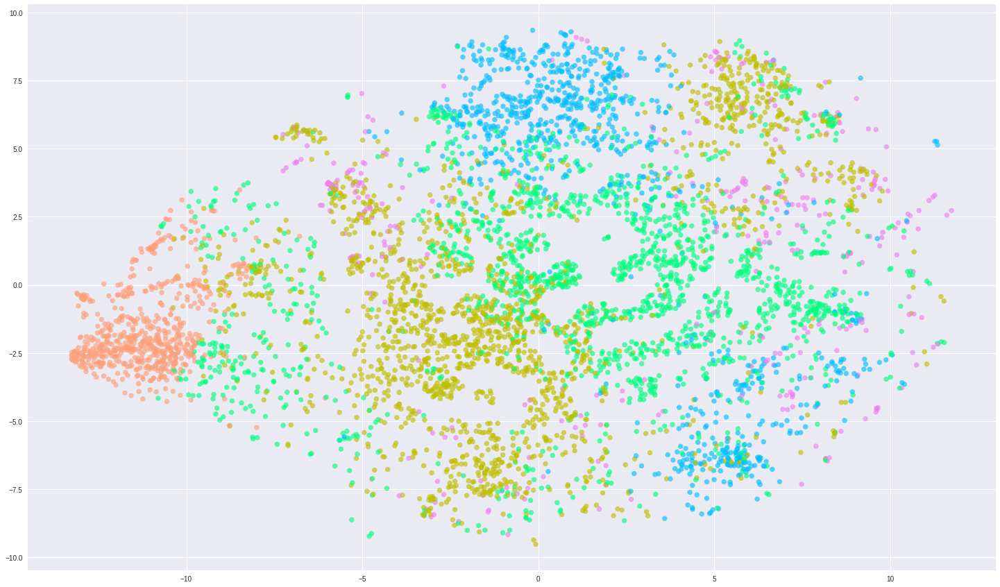

Gen 23...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 451 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 14.184s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.010439
[t-SNE] KL divergence after 250 iterations with early exaggeration: 75.769981
[t-SNE] KL divergence after 500 iterations: 2.533182
Removing outliers. . .


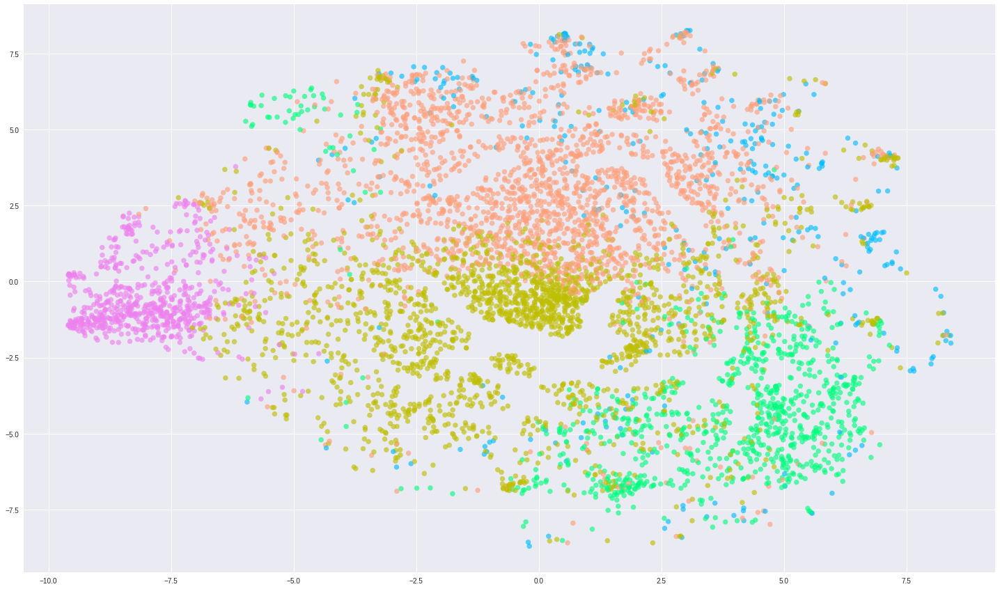

Gen 24...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 901 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.025s...
[t-SNE] Computed neighbors for 7761 samples in 14.988s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.114392
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.417648
[t-SNE] KL divergence after 500 iterations: 2.009192
Removing outliers. . .


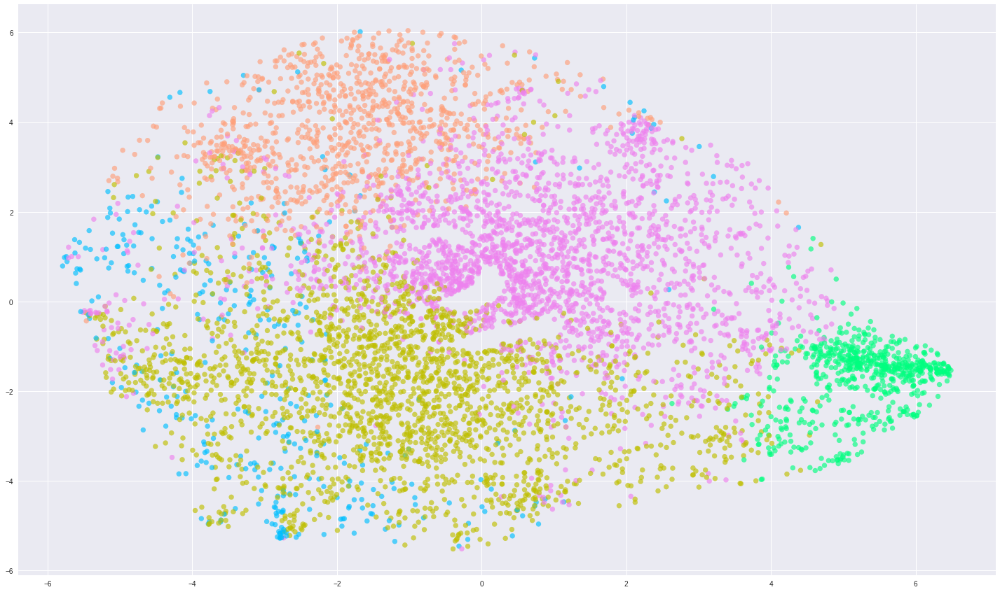

Gen 25...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 1501 nearest neighbors...
[t-SNE] Indexed 7761 samples in 0.024s...
[t-SNE] Computed neighbors for 7761 samples in 16.477s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7761
[t-SNE] Computed conditional probabilities for sample 2000 / 7761
[t-SNE] Computed conditional probabilities for sample 3000 / 7761
[t-SNE] Computed conditional probabilities for sample 4000 / 7761
[t-SNE] Computed conditional probabilities for sample 5000 / 7761
[t-SNE] Computed conditional probabilities for sample 6000 / 7761
[t-SNE] Computed conditional probabilities for sample 7000 / 7761
[t-SNE] Computed conditional probabilities for sample 7761 / 7761
[t-SNE] Mean sigma: 1.203864
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.083275
[t-SNE] KL divergence after 500 iterations: 1.660288
Removing outliers. . .


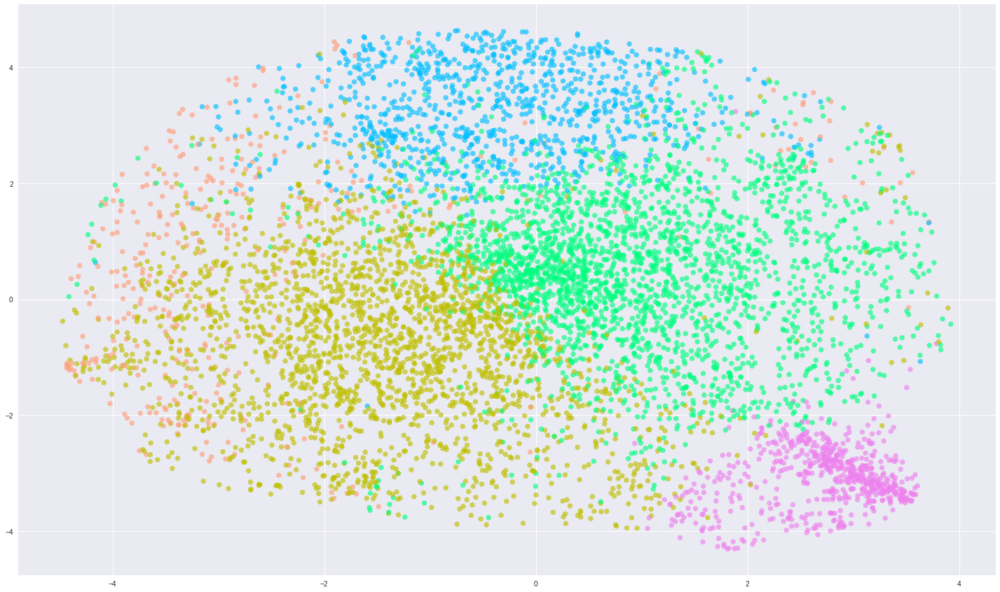

In [0]:
gridSearch = [{"embedder": "tsne", "perplexity":20 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":30 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":40 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":50 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":60 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":70 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":80 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":90 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":100 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":110 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":150 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":300 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":500 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":20 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":30 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":40 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":50 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":60 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":70 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":80 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":90 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":100 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":110 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":150 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":300 , "n_iter": 500, "exaggeration": 12},
             {"embedder": "tsne", "perplexity":500 , "n_iter": 500, "exaggeration": 12}]
for i,d in enumerate(gridSearch):
  print('Gen {}...'.format(i))
  plotEmbeddedWords(addText = False, **d)

Gen 0...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.014s...
[t-SNE] Computed neighbors for 3660 samples in 3.831s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 1.030702
[t-SNE] KL divergence after 250 iterations with early exaggeration: 18.361538
[t-SNE] KL divergence after 500 iterations: 2.195472
Removing outliers. . .


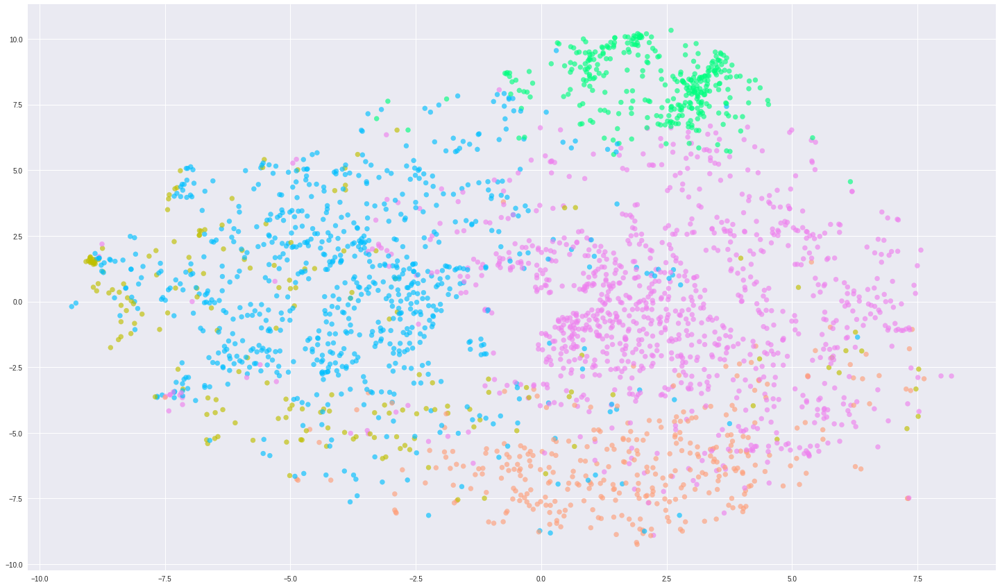

Gen 1...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 601 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.014s...
[t-SNE] Computed neighbors for 3660 samples in 4.169s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 1.147340
[t-SNE] KL divergence after 250 iterations with early exaggeration: 14.727782
[t-SNE] KL divergence after 500 iterations: 1.742278
Removing outliers. . .


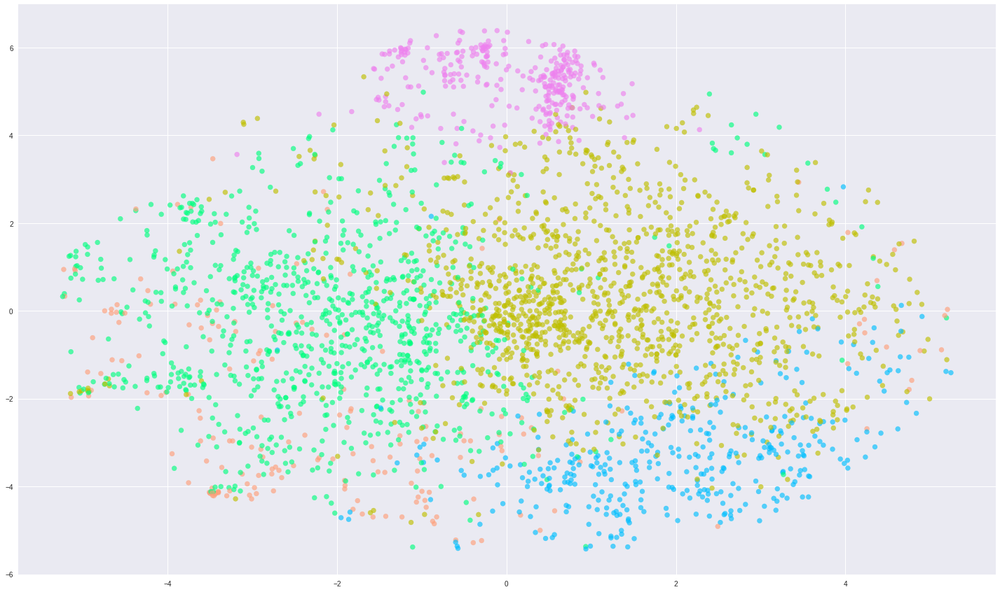

Gen 2...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 901 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.014s...
[t-SNE] Computed neighbors for 3660 samples in 4.402s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 1.225932
[t-SNE] KL divergence after 250 iterations with early exaggeration: 13.267003
[t-SNE] KL divergence after 500 iterations: 1.448256
Removing outliers. . .


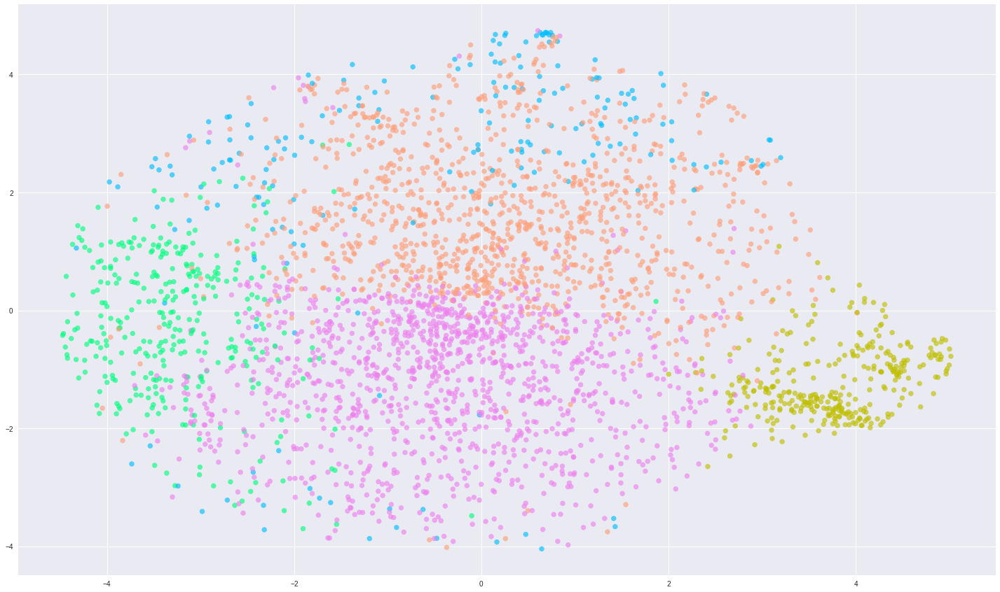

Gen 3...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 1201 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.014s...
[t-SNE] Computed neighbors for 3660 samples in 4.594s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 1.291300
[t-SNE] KL divergence after 250 iterations with early exaggeration: 12.272854
[t-SNE] KL divergence after 500 iterations: 1.249115
Removing outliers. . .


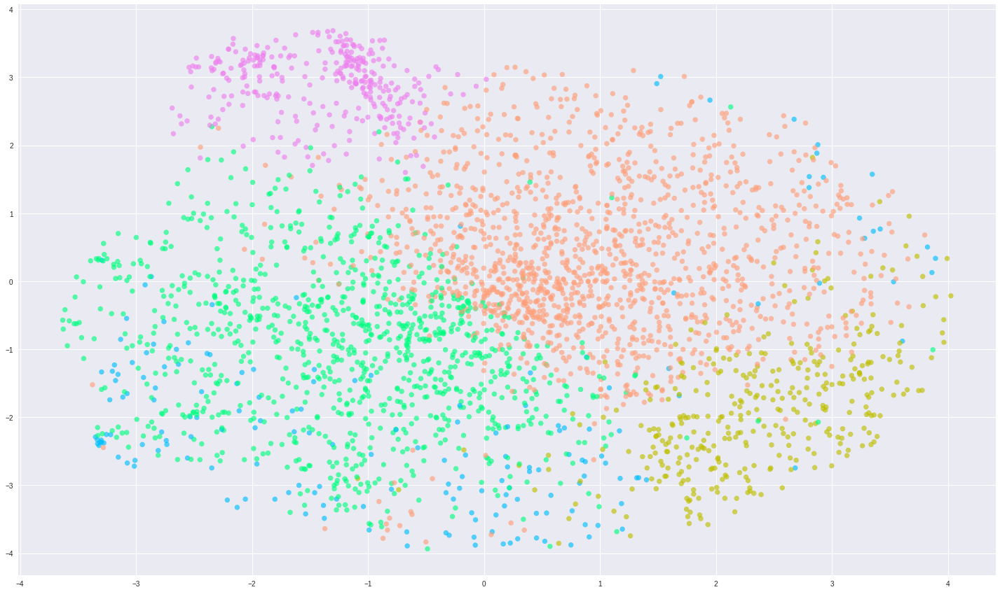

Gen 4...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 1501 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.014s...
[t-SNE] Computed neighbors for 3660 samples in 4.792s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 1.351160
[t-SNE] KL divergence after 250 iterations with early exaggeration: 11.484564
[t-SNE] KL divergence after 500 iterations: 1.135056
Removing outliers. . .


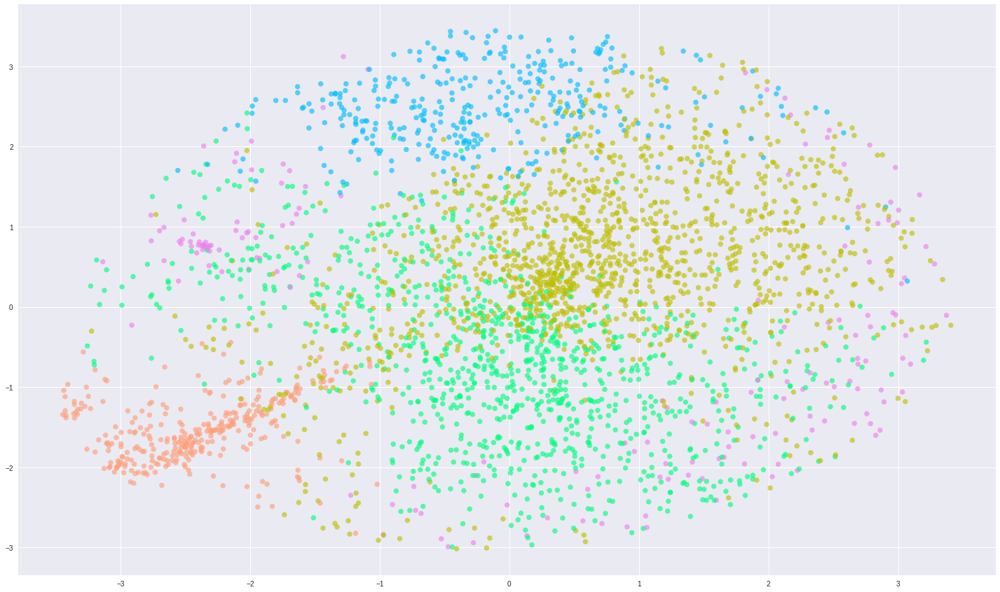

Gen 5...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 1801 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.013s...
[t-SNE] Computed neighbors for 3660 samples in 4.948s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 1.409443
[t-SNE] KL divergence after 100 iterations with early exaggeration: 10.846554
[t-SNE] KL divergence after 500 iterations: 0.985058
Removing outliers. . .


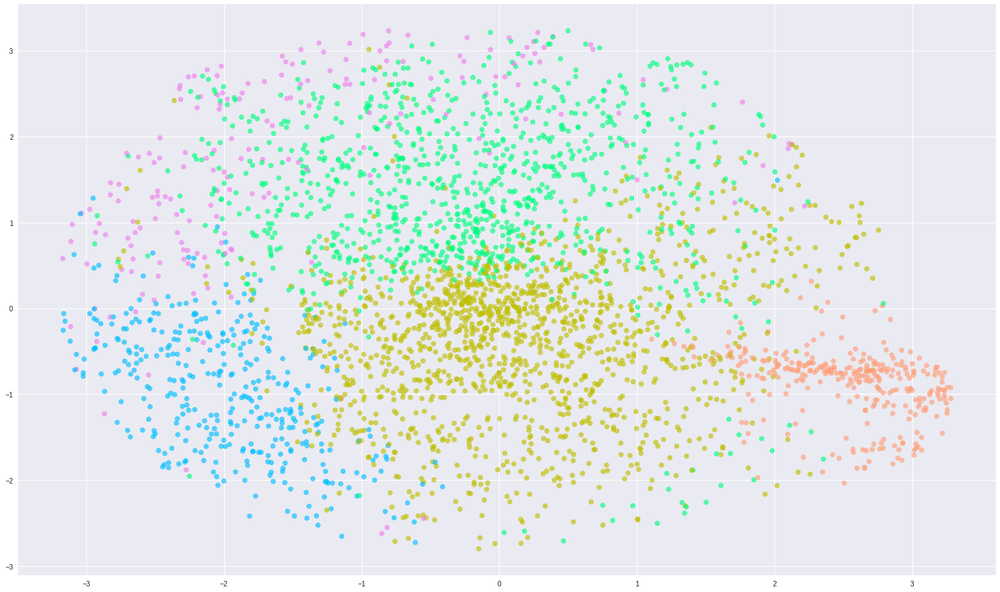

Gen 6...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 2101 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.000s...
[t-SNE] Computed neighbors for 3660 samples in 1.219s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 1.467539
[t-SNE] KL divergence after 50 iterations with early exaggeration: 10.315339
[t-SNE] KL divergence after 500 iterations: 0.867315
Removing outliers. . .


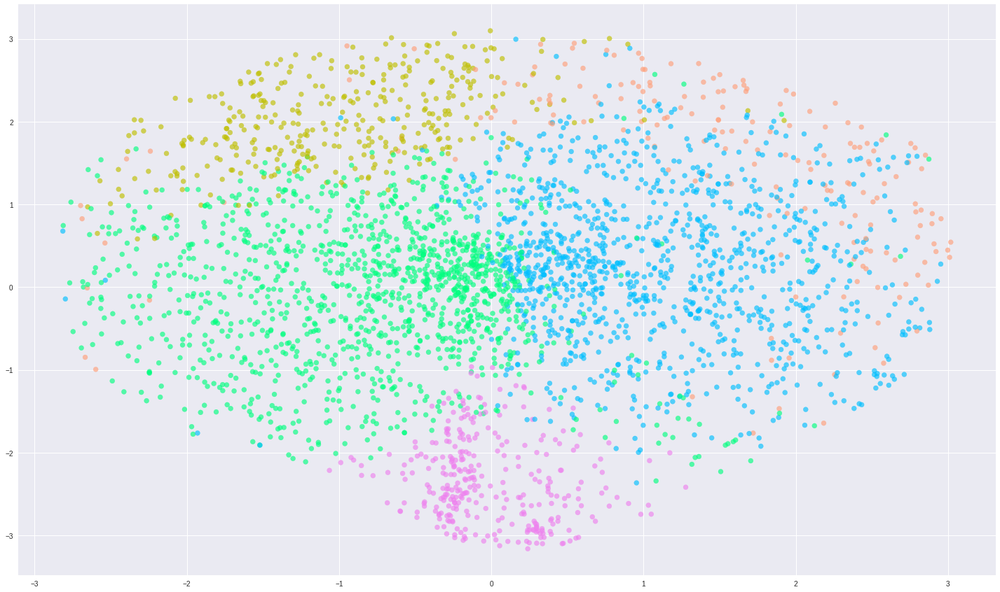

Gen 7...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 2401 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.000s...
[t-SNE] Computed neighbors for 3660 samples in 1.330s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 1.526646
[t-SNE] KL divergence after 50 iterations with early exaggeration: 9.855971
[t-SNE] KL divergence after 500 iterations: 0.772027
Removing outliers. . .


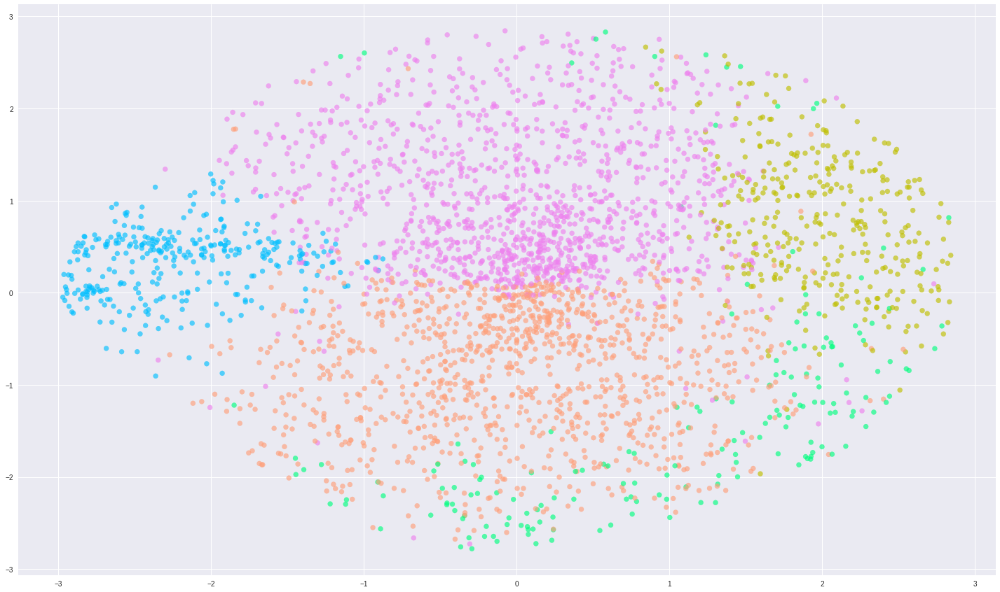

Gen 8...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 2701 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.000s...
[t-SNE] Computed neighbors for 3660 samples in 1.423s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 1.587077
[t-SNE] KL divergence after 50 iterations with early exaggeration: 9.453340
[t-SNE] KL divergence after 500 iterations: 0.688258
Removing outliers. . .


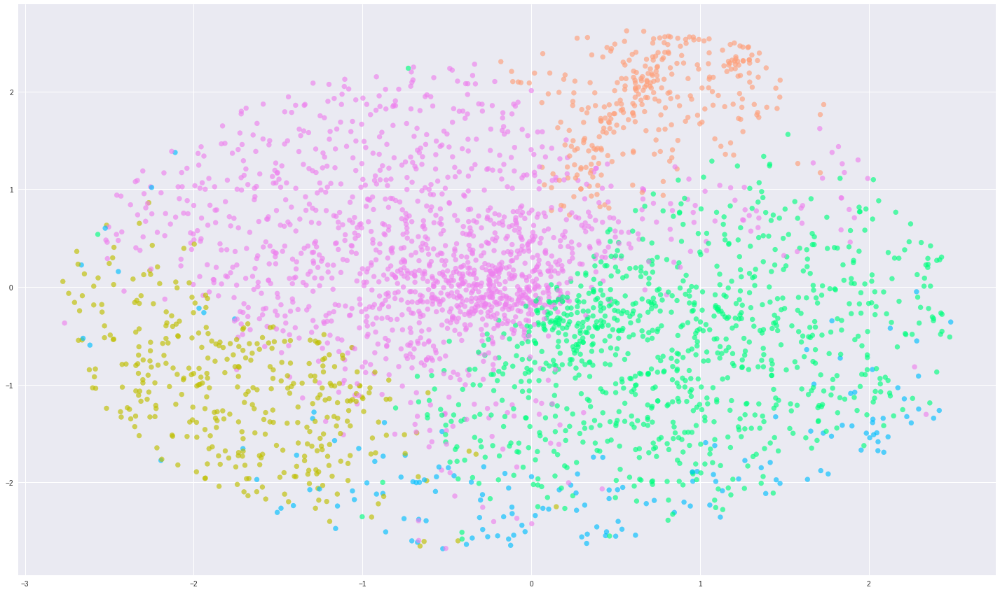

Gen 9...
Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 3001 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.001s...
[t-SNE] Computed neighbors for 3660 samples in 1.523s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 1.649039


KeyboardInterrupt: ignored

In [0]:
gridSearch = [{"embedder": "tsne", "perplexity":100 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":200 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":300 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":400 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":500 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":600 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":700 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":800 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":900 , "n_iter": 500, "exaggeration": 4},
             {"embedder": "tsne", "perplexity":1000 , "n_iter": 500, "exaggeration": 4}]
for i,d in enumerate(gridSearch):
  print('Gen {}...'.format(i))
  plotEmbeddedWords(addText = False, **d)

## Apophenia
Now that I have chosen the best parameters, I will enlarge the plot and add text into the mix. We must be very careful or else we'll just find paterns where there aren't any! To better view the plot, you can right-click on the sidebar and then select 'view output fullscreen'.<br/>
![alt text](https://drive.google.com/uc?id=1THHb7DvdWeg2JblFy8qz9zMqspkxtwfU)

Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.010s...
[t-SNE] Computed neighbors for 3660 samples in 2.445s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 0.394478
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.806870
[t-SNE] KL divergence after 600 iterations: 2.504417
Removing outliers. . .
Plotting words. . .
Adjusting overlapping text (This may take awhile). . .
40


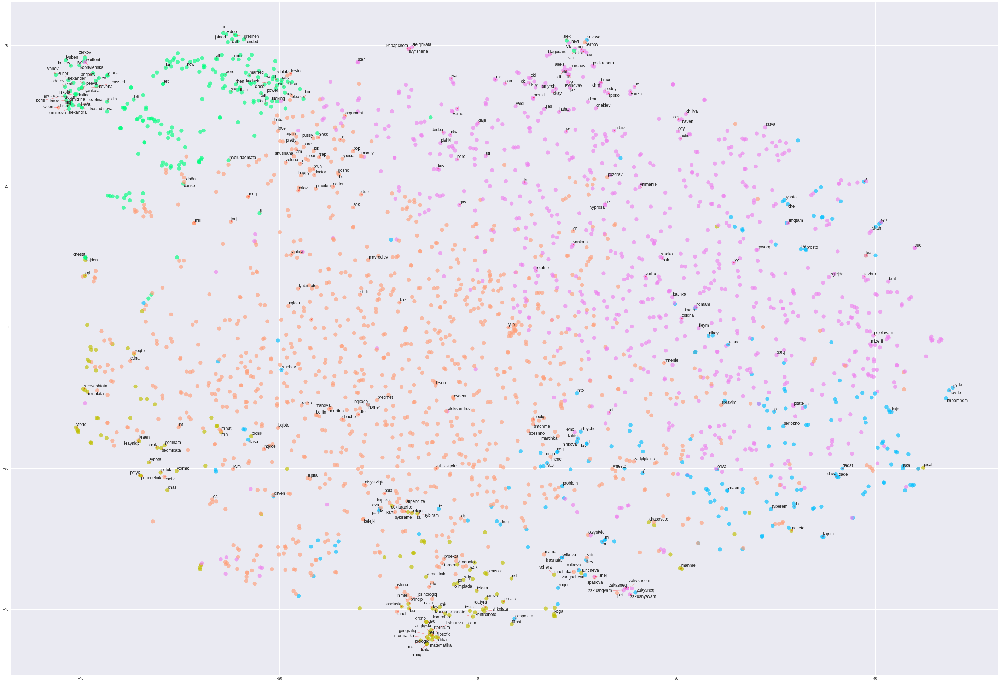

In [0]:
d = {"embedder": "tsne", "perplexity":20 , "n_iter": 600, "exaggeration": 12, 'big':True}
plotEmbeddedWords(True, 'big', **d)

Now with a few more words plastered around.

Constructing clusters. . .
Reducing dimensionality. . .
[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 3660 samples in 0.009s...
[t-SNE] Computed neighbors for 3660 samples in 2.514s...
[t-SNE] Computed conditional probabilities for sample 1000 / 3660
[t-SNE] Computed conditional probabilities for sample 2000 / 3660
[t-SNE] Computed conditional probabilities for sample 3000 / 3660
[t-SNE] Computed conditional probabilities for sample 3660 / 3660
[t-SNE] Mean sigma: 0.421125
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.276352
[t-SNE] KL divergence after 500 iterations: 2.390294
Removing outliers. . .
Plotting words. . .
Adjusting overlapping text (This may take awhile). . .
40


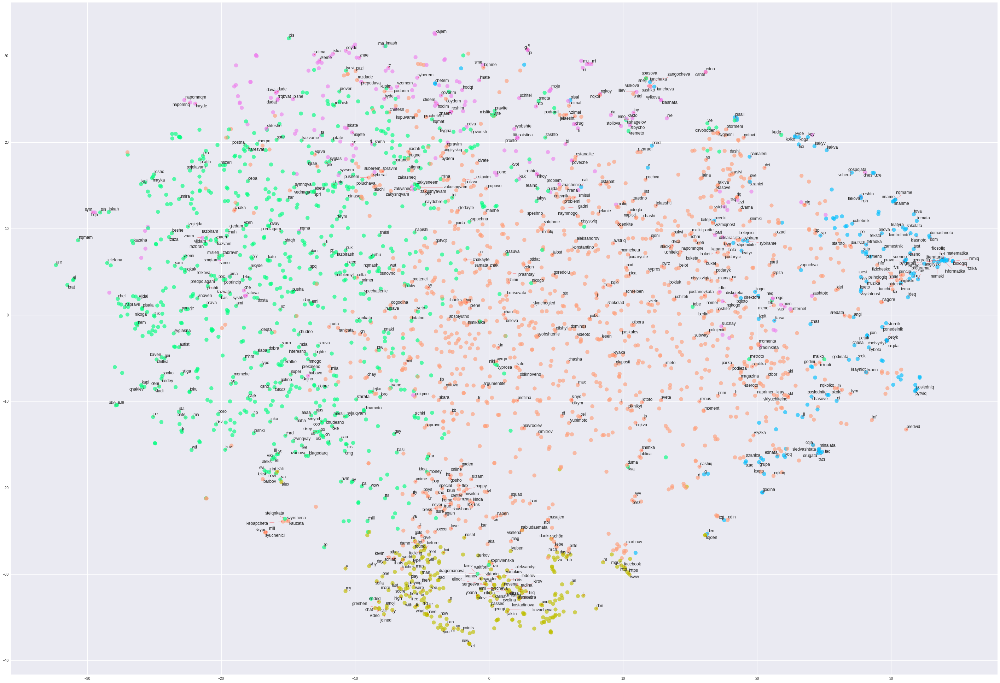

In [0]:
d = {"embedder": "tsne", "perplexity":30 , "n_iter": 500, "exaggeration": 12, 'big':True}
plotEmbeddedWords(True, 'big', **d)

#<a href='http://roubaixinteractive.com/PlayGround/Binary_Conversion/Binary_To_Text.asp' style="text-decoration:none;">01100110011100100110100101100101011011100110010001110011</a>
<font size='3'>Because making friends is hard and maintaining them is even harder.</font>

## Preparation
Here we do a little bit of specialized preparation, but in essence it's more of the same - get some good, clean, PG13(not really but it rhymes) latin words and vectorize them.

total chars: 49
nb sequences: 6901
[['zhertvame', 'gi', 'v', 'polza', 'na', 'kolektiva', 'kirev', 'e', 'vinoven', 'warten'], ['polza', 'na', 'kolektiva', 'kirev', 'e', 'vinoven', 'warten', 'ot', 'chasa', 'li'], ['kirev', 'e', 'vinoven', 'warten', 'ot', 'chasa', 'li', 'dnevnika', 'changed', 'the'], ['warten', 'ot', 'chasa', 'li', 'dnevnika', 'changed', 'the', 'chat', 'colors', 'imame'], ['li', 'dnevnika', 'changed', 'the', 'chat', 'colors', 'imame', 'ot', 'chasa', 'syshtoto'], ['the', 'chat', 'colors', 'imame', 'ot', 'chasa', 'syshtoto', 'zhaki', 'do', 'ima'], ['imame', 'ot', 'chasa', 'syshtoto', 'zhaki', 'do', 'ima', 'izpit', 'na', 'skypi'], ['syshtoto', 'zhaki', 'do', 'ima', 'izpit', 'na', 'skypi', 'syuchenici', 'byrz', 'vypros'], ['ima', 'izpit', 'na', 'skypi', 'syuchenici', 'byrz', 'vypros', 'zhelaete', 'li', 'da'], ['skypi', 'syuchenici', 'byrz', 'vypros', 'zhelaete', 'li', 'da', 'kupuvame', 'buketi', 'na'], ['vypros', 'zhelaete', 'li', 'da', 'kupuvame', 'buketi', 'na', 'vsichki', 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:28: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:29: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).


In [0]:
def sample(preds, temperature=1.0):
    # helper function to sample an index from a probability array
    preds = np.asarray(preds).astype('float64')
    preds = np.log(preds) / temperature
    exp_preds = np.exp(preds)
    preds = exp_preds / np.sum(exp_preds)
    probas = np.random.multinomial(1, preds, 1)
    return np.argmax(probas)


def on_epoch_end(epoch, _):
    model.save('gdrive/My Drive/Models/textModel3.h5')
    # Function invoked at end of each epoch. Prints generated text.
    print()
    print('----- Generating text after Epoch: %d' % epoch)
    start_index = random.randint(0, len(text) - maxlen - 1)
    for diversity in [0.05, 0.2, 0.5]:
        
        print('----- diversity:', diversity)

        generated = ''
        sentence = text[start_index: start_index + maxlen]
        generated += sentence
        print('----- Generating with seed: "' + sentence + '"')
        sys.stdout.write(generated)

        for i in range(400):
            x_pred = np.zeros((1, maxlen, len(chars)))
            for t, char in enumerate(sentence):
                x_pred[0, t, char_indices[char]] = 1.

            preds = model.predict(x_pred, verbose=0)[0]
            next_index = sample(preds, diversity)
            next_char = indices_char[next_index]

            generated += next_char
            sentence = sentence[1:] + next_char

            sys.stdout.write(next_char)
            sys.stdout.flush()
        print()

print_callback = LambdaCallback(on_epoch_end=on_epoch_end)

In [0]:
print('Build model...')
model = Sequential()
model.add(LSTM(256, input_shape=(maxlen, len(chars)), return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(256))
model.add(Dropout(0.2))
model.add(Dense(len(chars), activation='softmax'))

optimizer = Adam(lr=0.0005, beta_1 = 0.9)
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics = ['accuracy'])

model.fit(x, y,
          batch_size=128,
          epochs=60,
callbacks=[print_callback])

In [0]:
model = load_model('gdrive/My Drive/Models/textModel.h5')
optimizer = Adam(lr=0.0001, beta_1 = 0.9)
model.compile(loss='categorical_crossentropy', optimizer=optimizer,  metrics=['accuracy'])
print_callback = LambdaCallback(on_epoch_end=on_epoch_end)
print_callback5 = LambdaCallback(on_epoch_end=on_epoch_end5)
model.fit(x, y,
          batch_size=128,
          epochs=60,
          callbacks=[print_callback],
         )

In [0]:
from textgenrnn import textgenrnn

my_file = open("text.txt", 'w+', encoding='utf-8')
text = getTextFromUser(['Alex Savova'])
text = remove_rare_chars(text,50)

print("header",file=my_file)
print(text,file=my_file)
my_file.close()

textgen = textgenrnn()
textgen.train_from_file('text.txt',
                        new_model=True,
                        num_epochs=200,
                        gen_epochs=5,
                        word_level=True,
                        train_size=0.85,
                        dropout=0.3)